## Libraries, Data initialization!

In [ ]:
import sys
sys.path.insert(1, '/users/koketso/BYOL_new')    #some important scripts in here, visualizations, custom datasets, etc
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision as tv
import numpy as np
import glob
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from torchvision.utils import save_image
import torchvision 
import torch
from IPython.display import display,clear_output
import backbone.VISUAL as viz
import backbone.Imagefolder as imf
import importlib
import pickle
import backbone.Custom as cust
from torch import Tensor
import backbone.Test as test
import time

import backbone.MiraBest as mb
importlib.reload(test)

# Define the directory of your dataset
meerkatn_dir = "/idia/projects/hippo/Koketso/meerkat/meerkat_wild"
meerkat_dir = "/idia/projects/hippo/Koketso/meerkat_resized"
meerkat_curated = "/idia/projects/hippo/Koketso/meerkat/meerkat_curated"
meerkat_curatedr = "/idia/projects/hippo/Koketso/meerkat/meerkat_curated_resized"



#Galaxy_zoo directories
galaxyzooq_dir = "/idia/projects/hippo/Koketso/galaxyzoo/resized/galaxy_zoo_class"
galaxyzooqns_dir = "/idia/projects/hippo/Koketso/galaxyzoo/nonresized/galaxy_zoo_class_sigma"
galaxyzooqn_dir = "/idia/projects/hippo/Koketso/galaxyzoo/nonresized/galaxy_zoo_class2"



galaxyzoo_dir = "/idia/projects/hippo/Koketso/galaxyzoo/galaxy_zoo"
galaxyzoo_all_dir = "/idia/projects/hippo/Koketso/galaxyzoo/galaxy_zoo_12"

#Hand_sign dataset

hand_dir = "/idia/projects/hippo/Koketso/Train_Alphabet"
handt_dir = "/idia/projects/hippo/Koketso/Test_Alphabet"

#Imagenet
im13_dir = "/idia/projects/hippo/Koketso/ILSVRC/Data/DET/train/ILSVRC2013_train"
im12_dir =  "/idia/projects/hippo/Koketso/ILSVRC/Data/DET/test"
dogbreed_dir = "/idia/projects/hippo/Koketso/dog_breeds"


#Which dataset are you analaysing

In [34]:
importlib.reload(cust)
Dir = galaxyzoo_dir
dataset = torchvision.datasets.ImageFolder(Dir)
classes = imf.classes(Dir)
names = [name[0].split('/')[-1] for name in dataset.imgs]
summ = sum(viz.groups(classes))
summ

231734

In [105]:
import sys
sys.path.insert(1, '/users/koketso/BYOL_new')

In [106]:
sys.path

['/users/koketso/BYOL_new/Features',
 '/users/koketso/BYOL_new',
 'BYOL_new',
 'BYOL_new3',
 'BYOL_new',
 '/BYOL_new',
 '/BYOL_new',
 '/BYOL_new',
 '/Feature extraction/backbone',
 '/Feature extraction/backbone',
 '/Feature extraction/backbone',
 '/usr/lib/python38.zip',
 '/usr/lib/python3.8',
 '/usr/lib/python3.8/lib-dynload',
 '',
 '/idia/projects/hippo/Koketso/deepclustering2/lib/python3.8/site-packages',
 '/idia/projects/hippo/Koketso/deepclustering2/lib/python3.8/site-packages/apex-0.1-py3.8.egg']

In [107]:
import Features.backbone.Custom as Custom


In [3]:
#Mirabest
resize = 300
transform = tv.transforms.Compose([
                            #tv.transforms.ToPILImage(),
                            #tv.transforms.Resize((424,424)),
                            tv.transforms.Resize((resize,resize)),
                            tv.transforms.CenterCrop(224),           # So they are compatible with the dnn models
                            tv.transforms.Grayscale(num_output_channels=3),
                            tv.transforms.ToTensor()
                            #tv.transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                            ])
importlib.reload(mb)

transformed_dataset = mb.MBFRFull(root='./batches', train=True, download=True, transform=transform) 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


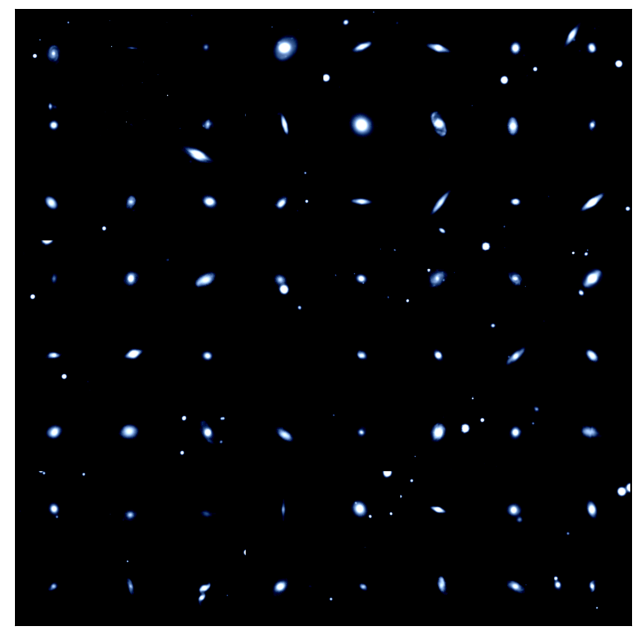

In [4]:
importlib.reload(cust)
Dir = galaxyzoo_dir
dataset = torchvision.datasets.ImageFolder(Dir)
names = [name[0].split('/')[-1] for name in dataset.imgs]
transformed_dataset = cust.Custom(dataset,names =names,resize = 244,crop = 224)#,mean=None,std=None)    
#transformed_dataset = mb.MBFRConfident(root='./batches', train=True, download=True, transform=transform) 

# Visualize a sample of your datase
batch_size = 8*8

loader = DataLoader(transformed_dataset, 
                    batch_size, 
                    shuffle = True)

def show_images(images, nmax=batch_size):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid((images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
def show_batch(dl, nmax=20*20):
    for images,names in dl:
        show_images(images, nmax)
        break
    
        
show_batch(loader)

## Loading Model

### Loading pretrained feature extractor

In [5]:
#deepcluster imports
sys.path.insert(1, '/deepcluster') 
import deepcluster.models as models



model = models.__dict__['alexnet']('store_true')
checkpoint = torch.load("deepcluster/checkpoint.pth.tar")
model.top_layer = None
model.features = torch.nn.DataParallel(model.features)
model.features.module[0] = torch.nn.Conv2d(3, 96, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
model.sobel = None


for key in torch.load("deepcluster/checkpoint.pth.tar")['state_dict']:
    if 'top_layer' in key:
        del checkpoint['state_dict'][key]
        

model.load_state_dict(checkpoint['state_dict'])
model.top_layer = torch.nn.Identity()
model.sobel = torch.nn.Identity()

In [89]:
import kornia.augmentation as K
class RandomRotationWithCrop(K.RandomRotation):
    def __init__(self, degrees, crop_size, output_dim = 244,p = 0.5):
        super(RandomRotationWithCrop, self).__init__(degrees, p = 1)
        #super(RandomRotationWithCrop, self).__init__(crop_size)
        self.rotation_transform = K.RandomRotation(degrees)
        self.crop_transform = K.CenterCrop(crop_size, keepdim = False,align_corners = True)
        self.resize_transform = K.Resize(output_dim)
    def __call__(self, x):
        if random.random() <self.p:
            # Apply random rotation
            x = self.rotation_transform(x)

            # Apply center crop
            x = self.crop_transform(x)
            x = self.resize_transform(x)

In [19]:
torch.load("models_/"+model_name+".pt",map_location = "cpu")['epoch']

2

In [11]:
#model.load_state_dict(torch.load("models/model_gz_99cut.pt",map_location = torch.device("cpu")))


device = torch.device('cuda') if torch.cuda.is_available() else torch.device("cpu")

#Zoobot


model = tv.models.resnet18(weights =None)
#model = torchvision.models.vit_b_16(weights = "IMAGENET1K_SWAG_E2E_V1")
#zoobot_dict = torch.load("models_/old_models/checkpoints/epoch=17-step=2808.ckpt")['state_dict']

#loaded_dict = {k: zoobot_dict["model.0.features." +k] for k in model.features.state_dict()}

#model.features.load_state_dict(loaded_dict)

#model.classifier[1] = torch.nn.Linear(1280,100)

#model.classifier[1].weight.data.normal_(0,0.01)



#Fine tune
"""
fintuned = torch.load("models_/model_meerkat_zoobot.pt")
model.classifier[1] = torch.nn.Linear(1280,100)
model.classifier[1].weight.data.normal_(0,0.01)
fine_tuned = torch.load("models_/model_meerkat_zoobot.pt")
model.load_state_dict(fine_tuned)

"""


#Resnet

#model = torchvision.models.resnet34(weights = "IMAGENET1K_V1")
#model = torchvision.models.resnet18(weights = "IMAGENET1K_V1")
#model = torch.hub.load('pytorch/vision:v0.10.0', 'resnet512', pretrained=True)
"""
model.layer4[1].bn2 = torch.nn.Identity()
model.layer4[1].conv2 = torch.nn.Identity()
model.layer4[1].bn1 = torch.nn.Identity()
#model.layer4[1].conv1 = torch.nn.Identity()

"""

#model.classifier[1] = torch.nn.Linear(1280,100)
#model.classifier[1] = torch.nn.Linear(1280,100)
"Model trained on 3 class name r34bigzbyol.pt"

#model.fc.weight.data.normal_(0,0.01)
model.fc  = torch.nn.Linear(512, 100)
model_name = "Resnet18_final_All_LS"

model.load_state_dict(torch.load("models_/"+model_name+".pt",map_location = "cpu")['model_state_dict'])




model.train(mode = False)

"""
for m in model.modules():
  if isinstance(m, torch.nn.BatchNorm2d):
    m.eval()
"""

#device = torch.device('cpu')
model.to(device)
model

## Feature extraction

#Remove the dataset sepecific section of the model, we want the feature extractor only
#model.head = torch.nn.Identity()
#model.classifier[6] = torch.nn.Identity()
#model.classifier[5] = torch.nn.Identity()
#model.fc  = torch.nn.Linear(512, 27)
#model.load_state_dict(torch.load("model.pth"))
model.head = torch.nn.Identity()
model.heads = torch.nn.Identity()
model.classifier = torch.nn.Identity()
model.fc = torch.nn.Identity()

#galaxyzooqn_dir = "/idia/projects/hippo/Koketso/galaxyzoo/nonresized/galaxy_zoo_class"



#Dir = meerkat_curated
#Dir = "/idia/projects/hippo/Koketso/imagenette2/train"
#Dir = dogbreed_dir

batch_size = 32

resize = 300
print(resize)
importlib.reload(cust)
Dir = galaxyzoo_all_dir
#Dir = "/idia/projects/hippo/Koketso/galaxyzoo/galaxy_zoo_12/"

dataset = torchvision.datasets.ImageFolder(Dir)
datasets = cust.train_val_dataset(dataset, val_split = 0.005)
names = [name[0].split('/')[-1][0:-4] for name in dataset.imgs]
names = cust.train_val_dataset(names, val_split = 0.005)
val_names = names['train']

300


In [12]:
classes = imf.classes(Dir)
summ = sum(viz.groups(classes))
print(summ)


#initialize image dataset with appropriate transformations
#datasets = cust.train_val_dataset(dataset, val_split = 20)

importlib.reload(cust)
transformed_dataset = cust.Custom_labelled(datasets['train'],
                                           names = val_names,
                                           resize = resize,
                                           crop = 244,
                                           mean=[0.485, 0.456, 0.406],
                                           std=[0.229, 0.224, 0.225]
                                           )   

#transformed_dataset = mb.MBFRConfident(root='./batches', train=True, download=True, transform=transform) 

loader = DataLoader(transformed_dataset, 
                    batch_size, 
                    shuffle = True,
                    num_workers = 16)
time1 = time.time()
rep = []
labells = []
names = []
images = []
name = "_"
label = 0
i = 0
with torch.no_grad():
    for image,label,name in loader:                                   #name
        if i*batch_size > 300000:
            break;
        #images.append(image)
        image = image.to(device)
        rep.append(model(image))                 #Modify to model used here
        labells.append(label)

        names.append(name)                      #name
        i+=1

        clear_output(wait = True)
        display(i*batch_size)


47680

In [13]:
#Unwrappping the data
rep2 = []
labells2 = []
rep2 = []
images2 = []
names2 = []



for i in range(len(rep)):
    for j in range(len(rep[i])):
        #images2.append(images[i][j].cpu().numpy()) #Images
        rep2.append(rep[i][j].cpu().numpy())        #Representations
        labells2.append(labells[i][j].item())
        names2.append(names[i][j])                  #Error here if no names
       
rep = rep2
#images = images2 
labels = labells2

names = names2
representations = [rep,labels]

print(len(rep2[1])) 

512


In [ ]:
knn = []
knn.append(test.KNN_accuracy(rep,labels))
sil = []
rep = np.array(rep)
sil.append(test.silhuoette(rep,labels))
print(knn,sil)

In [ ]:
rep_2  = []
label_2 = []
name_2 = []
image_2 = []

for i in range(len(labels)):
    if labels[i] == 2:
        pass;
    else:
        rep_2.append(rep[i])
        label_2.append(labels[i])
        name_2.append(names[i])
        image_2.append(images[i])
label_2 = [int(a == 0) for a in label_2]
print(test.KNN_accuracy(rep_2,label_2),test.silhuoette(rep_2,label_2))

UMAP(low_memory=False, n_neighbors=20, random_state=43, transform_seed=4, verbose=True)
Wed Jul  5 15:25:45 2023 Construct fuzzy simplicial set
Wed Jul  5 15:25:45 2023 Finding Nearest Neighbors
Wed Jul  5 15:25:45 2023 Building RP forest with 16 trees
Wed Jul  5 15:25:45 2023 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	 4  /  16
	Stopping threshold met -- exiting after 4 iterations
Wed Jul  5 15:25:50 2023 Finished Nearest Neighbor Search
Wed Jul  5 15:25:51 2023 Construct embedding


Epochs completed: 100%| ██████████ 200/200 [00:44]


Wed Jul  5 15:26:39 2023 Finished embedding
Saved :  uembedded_dataset.txt
UMAP reduced in  55.121609687805176


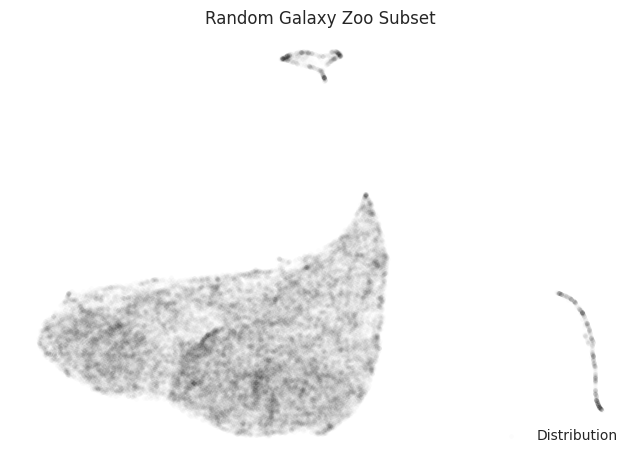

In [14]:
umap_ =viz.umap(rep,name ="Random Galaxy Zoo Subset", min_dist = 0.1, alpha = 0.01) #min_dist = 0.1 for hand sign data


In [17]:
#How many elements in each group?

viz.groups(labels)
#Check for representation Collapse
pca = viz.pca(data = rep,n_components = min([512,len(rep2[1])]), variance = 0.95)

Variance to keep :  0.9518389389062822  number of components :  28


In [ ]:
umap_1 =viz.umap(rep,name ="Galaxy Zoo Random Subset", min_dist = 0.1, n_neighbors = 10, alpha = 0.1) #min_dist = 0.1 for hand sign data

UMAP(low_memory=False, n_neighbors=20, random_state=43, transform_seed=4, verbose=True)
Thu Jun 22 15:21:32 2023 Construct fuzzy simplicial set
Thu Jun 22 15:21:32 2023 Finding Nearest Neighbors
Thu Jun 22 15:21:32 2023 Building RP forest with 16 trees
Thu Jun 22 15:21:33 2023 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	 4  /  16
	Stopping threshold met -- exiting after 4 iterations
Thu Jun 22 15:24:46 2023 Finished Nearest Neighbor Search
Thu Jun 22 15:24:49 2023 Construct embedding


Epochs completed: 100%| ██████████ 200/200 [00:42]


Thu Jun 22 15:25:39 2023 Finished embedding
Saved :  uembedded_dataset.txt
UMAP reduced in  249.9672474861145


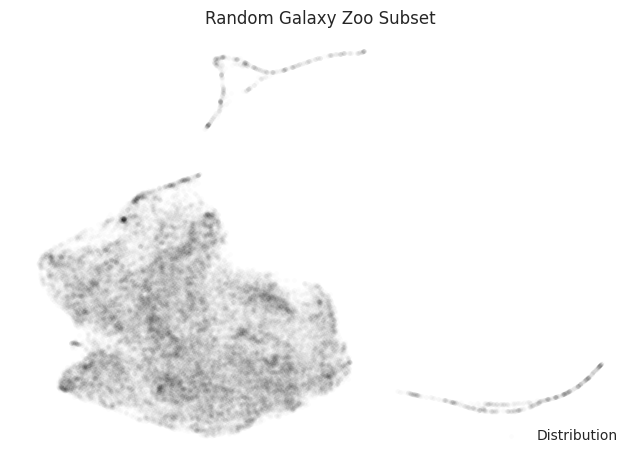

NameError: name 'labels' is not defined

In [5]:
#pca = viz.pca(data = rep,n_components = min([512,len(rep2[1])]), variance = 0.99)
umap_ =viz.umap(rep,name ="Random Galaxy Zoo Subset", min_dist = 0.1 , alpha = 0.01) #min_dist = 0.1 for hand sign data
#umap_c =viz.umap(pca,name ="BYOL")


importlib.reload(viz)

print(int(max(labels)))

## Dimensionality Reduction and Visualizations

In [6]:
importlib.reload(viz)
arch = "Resnet18"
data = "Galaxy Zoo Random"

# Change labels here when dealing with imagefolder data:

#labels = [imf.score(image_name = name.split('.')[0]) for name in names]
#labels = [label-1 for label in labels]


#Umap Sahde

In [14]:
#Classes
legendd = []
print(dataset.class_to_idx)
for i in dataset.class_to_idx:
    legendd.append(i)

{'edge-on_elliptical': 0, 'face-on_elliptical': 1, 'face-on_spiral': 2}


In [ ]:
with open(Class_file2, 'rb') as f:
    text = f.read()
    print(text)

## Explore the distribution of known morphologies

In [7]:
#Or
import pandas as pd
importlib.reload(pd)
Class_file = "/idia/projects/hippo/Koketso/gz_decals_volunteers_5.csv?download=1.1"
Class_file = "/idia/projects/hippo/Koketso/gz_decals_volunteers_1_and_2.csv"
Class_file2 = "/idia/projects/hippo/Koketso/gz_decals_auto_posteriors.parquet?download=1"
"""
Class_file = pd.read_csv(Class_file)
Class_file.set_index("iauname",
            inplace = True)
"""

Class_file2 = pd.read_csv(Class_file) 
Class_file2.set_index("iauname",
            inplace = True)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


[46153, 1526]
Plotting


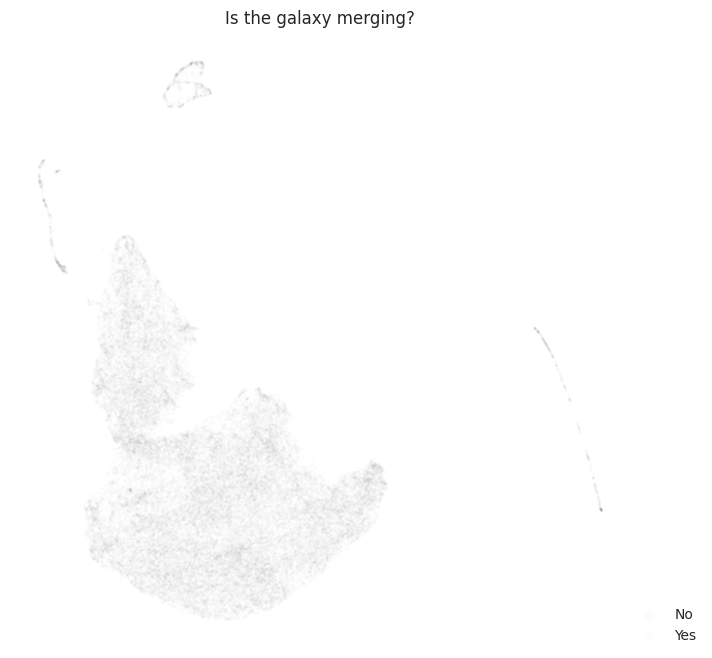

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


[40879, 6800]
Plotting


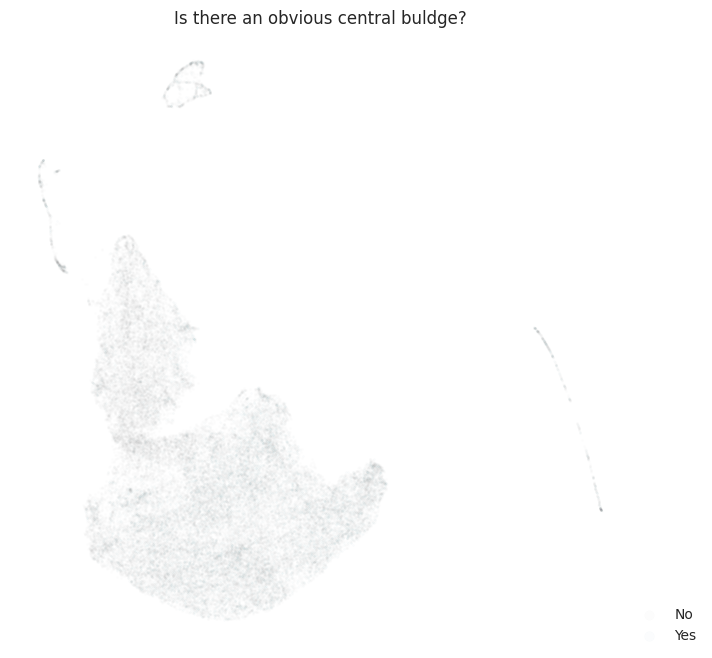

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


[43186, 4493]
Plotting


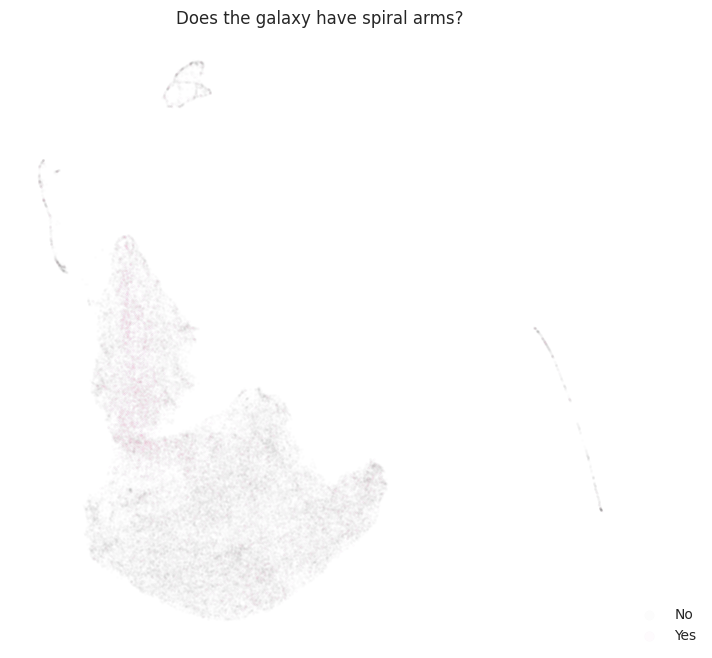

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


[44598, 3081]
Plotting


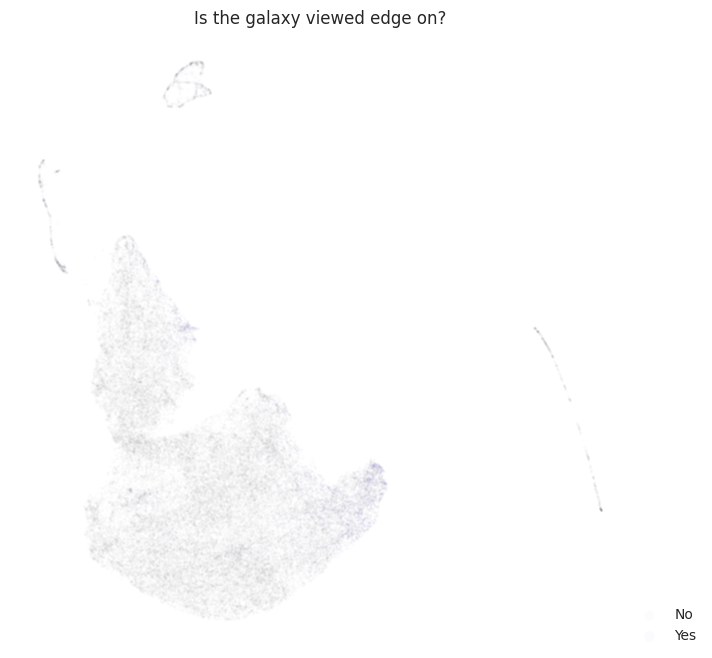

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


[38002, 9677]
Plotting


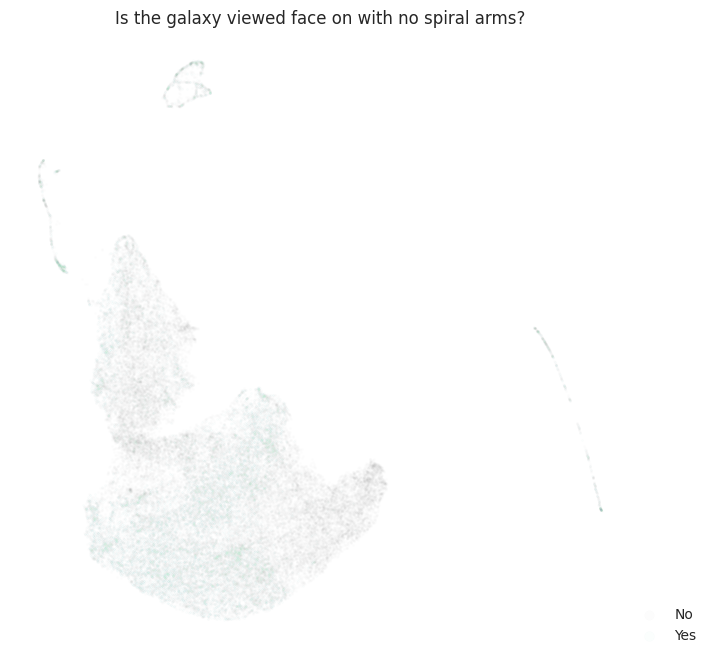

In [9]:
alpha = 0.01
questions = [ 
            "merging_merger_fraction",
            "bulge_size_obvious_fraction",
            "has_spiral_arms_yes_fraction",
            "disk_edge_on_yes_fraction",
            "combine some"
    ]
cut_thresholds = [0.5,0.99,0.9,0.9,0.1]
plot_names = ["Is the galaxy merging?","Is there an obvious central buldge?","Does the galaxy have spiral arms?","Is the galaxy viewed edge on?", "Is the galaxy viewed face on with no spiral arms?"]
for i in range(len(questions)):
    question = questions[i]
    plot_name = plot_names[i]
    cut_threshold = cut_thresholds[i]
    labels = []
    for name in names:
        if i == len(questions)-1:           # if we are at the last and a bit more complicated question
            try:
                labels.append(int(Class_file2.loc[name]["has_spiral_arms_yes_fraction"]<0.10 and Class_file2.loc[name]["disk_edge_on_yes_fraction"]<0.10))
            except:
                labels.append(0)
        else:
            try:
                labels.append(int(Class_file2.loc[name][question]>cut_threshold))
            except:
                labels.append(0)
            


    print(viz.groups(labels))   
    legendd = ["No","Yes"]
    viz.shade(umap_,labels,numof_class = int(max(labels))+1,alpha = alpha,name =plot_name ,label = True,gz = True, legendd = legendd, faint_class = 1,limits = None)#[-6,7,-5,8])#["Boring","Normal","Plumes","S_shaped","Unknown"] )

In [126]:
names = [name[0:-4] for name in names]

Plotting


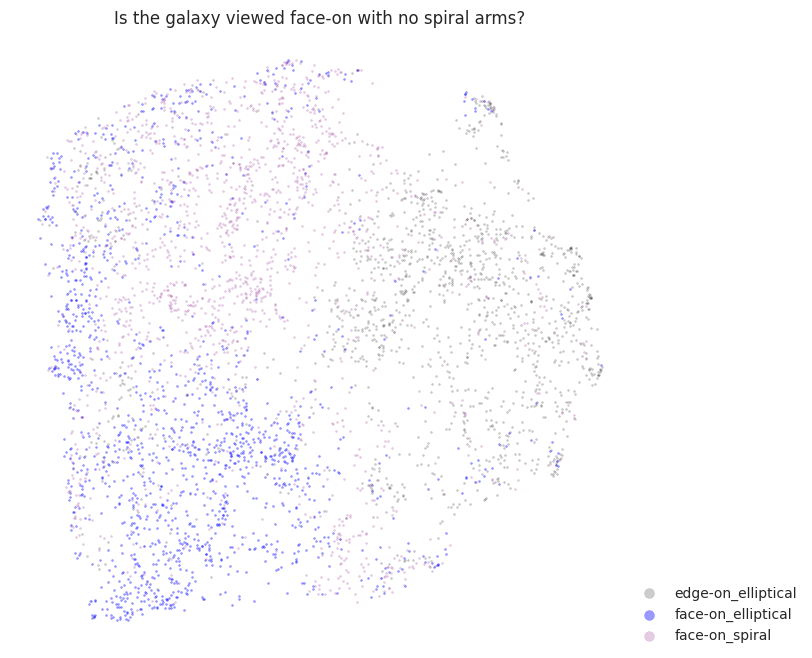

In [15]:
alpha = 0.2
importlib.reload(viz)

viz.shade(umap_,labels,numof_class = int(max(labels))+1,alpha = alpha,name = "Is the galaxy viewed face-on with no spiral arms?",label = True,gz = True, legendd = legendd, faint_class = 1,limits = None)#[-6,7,-5,8])#["Boring","Normal","Plumes","S_shaped","Unknown"] )

In [ ]:
viz.shade(tmap,labels,numof_class = int(max(labels))+1,alpha = 0.1,name = "UMAP " + data +" " +arch,label = True,gz = True,limits = [-250,150,-200,300], legendd = ["Edge-On","Round Elliptical","Spiral"])#["Boring","Normal","Plumes","S_shaped","Unknown"] )


In [43]:
importlib.reload(viz)

labels = []
for name in names:
    try:
        labels.append(int(Cljass_file2.loc[name]["has_spiral_arms_yes_fraction"]<0.10 and Class_file2.loc[name]["disk_edge_on_yes_fraction"]<0.10))
    except:
        labels.append(0)
        
print(viz.groups(labels))

[230575]


Plotting


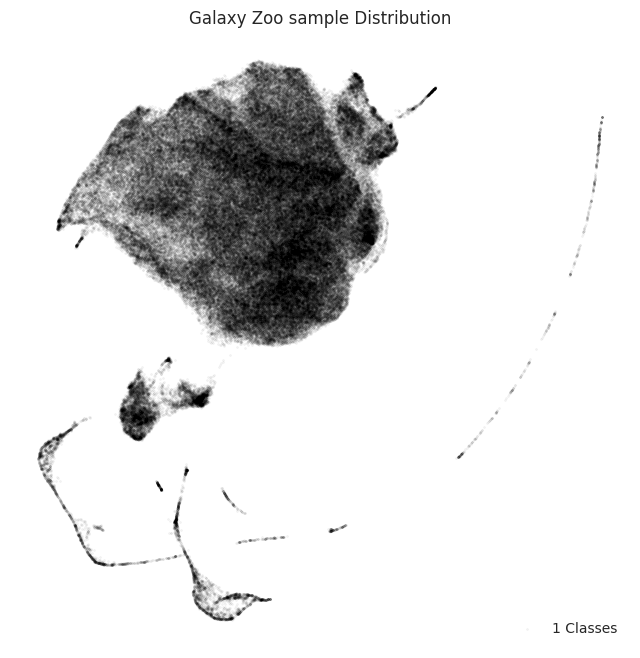

In [47]:
alpha = 0.05


viz.shade(umap_,labels,numof_class = int(max(labels))+1,alpha = alpha,name = "Galaxy Zoo sample Distribution",label = False,gz = False, legendd = legendd, faint_class = None,limits = None)#[-6,7,-5,8])#["Boring","Normal","Plumes","S_shaped","Unknown"] )

In [ ]:
import trimap

rep = np.array(rep)
tmap = trimap.TRIMAP(n_inliers=20,
                          n_outliers=11,
                          n_random=10).fit_transform(rep)


#tMAP shade

viz.shade(tmap,labels,numof_class = int(max(labels))+1,alpha = 0.01,name = "triMAP "+data+" "+ arch,label = True,gz = True, legendd = legendd, faint_class = None)

#umap_c =viz.umap(pca,name ="BYOL",dim = 10)

#import pacmap

In [ ]:
viz.shade(tmap,labels,numof_class = int(max(labels))+1,alpha = 0.15,name = "UMAP " + data +" " +arch,label = True,gz = True,limits = [-150,150,-150,150], legendd = ["Edge-On","Round Elliptical","Spiral"])#["Boring","Normal","Plumes","S_shaped","Unknown"] )


In [ ]:
pmap_= pacmap.PaCMAP(n_components=2, n_neighbors=None, MN_ratio=0.5, FP_ratio=4, random_state = 42) 
pmap_2 = pmap_.fit_transform(rep, init = "pca")

viz.shade(pmap_2,labels,numof_class = int(max(labels))+1,alpha = 1,name = "PaCMAP Mirabest Resnet18",label = True,gz = True, legendd = ["Centre Brightened","Edge Brightened","Spiral"])

# Visualize Losses stores in the loss subfolder

In [22]:
import pickle
train_loss_saved = "losses/gz99cut_resnet18_testloss.plk"
val_loss_saved = "losses/loss_byol_galaxy_zoo.plk"
m_z= "losses/loss_byol_hand_resnet18.plk"
m_z_2= "losses/res18byol_00.plk"


m_z_2 = "losses/Resnet18_final_All_randomWeightsaccuracies.plk"
with open(m_z_2,'rb') as file:
    losses = pickle.load(file)

In [23]:
import backbone.Test as test
actual_accuracies2 = []
for features,labels in losses:
    val_ac = test.KNN_accuracy(features,labels)
    print(val_ac)
    actual_accuracies2.append(val_ac)

(70.56, 0.2)
(74.68, 0.17)
(77.49, 0.16)
(80.02, 0.18)
(80.49, 0.14)
(80.56, 0.16)
(81.65, 0.19)
(82.38, 0.17)
(79.52, 0.19)


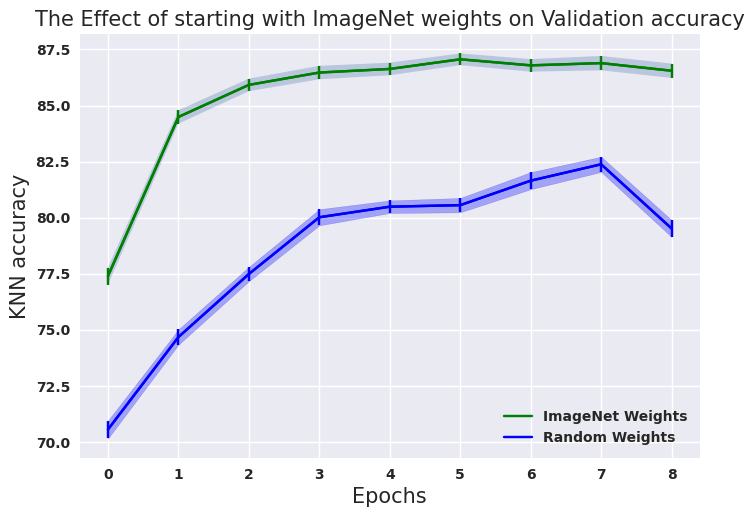

In [32]:
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 22}

matplotlib.rc('font', **font)
fig = plt.figure()
x = np.arange(len(actual_accuracies))
y = np.array([float(item[0]) for item in actual_accuracies])
yerr = np.array([2*float(item[1]) for item in actual_accuracies])

plt.plot(x,y,markersize=5,label  = "ImageNet Weights", c = "green")
plt.fill_between(x, y-yerr, y+yerr, alpha=.3)
plt.errorbar(x, y, yerr=yerr,c = "green")



x2 = np.arange(len(actual_accuracies2))
y2 = np.array([float(item[0]) for item in actual_accuracies2])
yerr2 = np.array([2*float(item[1]) for item in actual_accuracies2])

plt.plot(x2,y2,markersize=5,label  = "Random Weights", c = "blue")
plt.fill_between(x2, y2-yerr2, y2+yerr2, color = "blue",alpha = .3)
plt.errorbar(x2, y2, yerr=yerr2, c = "blue")

plt.title("The Effect of starting with ImageNet weights on Validation accuracy", fontsize = 15)
plt.ylabel("KNN accuracy",fontsize = 15)
plt.xlabel("Epochs",fontsize = 15)
plt.legend(loc='lower right')
plt.show()

# Features to pandas to CSV

In [32]:
names = [name[0:-4] for name in names]

In [ ]:
import pandas as pd

importlib.reload(imf)

#labels = [imf.score(image_name = name.split('.')[0]) for name in names]
#tags = [imf.tag(image_name = name.split('.')[0]) for name in names]
#names = name_2#[name.split('.')[0] for name in names]
# initialize data of lists.
data = {'Image Name': names,
        
      }

#Create Dataframe
df = pd.DataFrame(data)
df.set_index("Image Name")


# Insert the representations
for i in range(len(rep[0])):
    df.insert(i+1,"Feature: "+str(i),[a[i] for a in rep])
    
# Send to CSV

In [40]:
df

,Image Name,Feature: 0,Feature: 1,Feature: 2,Feature: 3,Feature: 4,Feature: 5,Feature: 6,Feature: 7,Feature: 8,...,Feature: 502,Feature: 503,Feature: 504,Feature: 505,Feature: 506,Feature: 507,Feature: 508,Feature: 509,Feature: 510,Feature: 511
0,J152810.17+283934.1,1.865537,1.908391,1.082183,0.302412,0.812664,0.533774,0.076174,1.013276,1.645332,...,3.010240,0.193963,1.446860,2.025961,0.540896,0.588161,0.506399,0.257341,1.335016,0.316795
1,J171300.21+282531.3,1.118589,0.255754,1.064493,0.585497,0.744621,0.413228,2.693954,0.726149,0.798042,...,1.199595,0.000000,0.627483,0.716616,0.888535,0.871225,0.060762,0.873039,0.108853,0.358711
2,J084740.81+292833.7,0.637034,0.274361,1.228431,0.032677,0.811247,0.647195,0.000000,0.760472,0.571777,...,0.797551,1.131442,0.104136,0.912621,0.593856,0.386301,0.059807,0.710307,1.396337,0.252903
3,J150933.21+220734.1,0.128222,0.206068,0.396914,1.065521,0.647630,0.319416,0.000000,1.473875,0.045355,...,1.234891,0.336021,1.008924,0.388180,1.761255,0.262394,0.109790,1.015043,0.219625,0.576248
4,J154507.48+250546.3,1.797486,0.074225,0.038484,1.569678,0.807889,0.680388,0.550662,0.801509,0.043576,...,0.797984,0.000000,0.010778,0.624034,0.017091,0.287844,0.915489,0.071579,0.000000,0.310329
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230570,J082557.25+100641.4,1.057137,1.474952,0.205570,0.477487,0.745717,3.158036,0.210317,0.490362,0.009555,...,1.562868,0.845790,0.063463,1.877705,0.354621,0.199318,0.005914,0.382662,0.027653,0.187480
230571,J165020.49+271355.2,0.419023,0.220039,1.634133,0.596157,0.790557,0.731435,2.498619,0.751997,0.800444,...,1.178883,0.000000,0.143732,0.120464,1.111575,1.131239,0.118749,0.150379,0.102261,0.237217
230572,J132129.86+052700.0,0.608462,0.147362,0.123390,1.769507,1.247184,0.594527,0.097308,1.983775,0.365841,...,0.014923,0.269794,3.146620,0.157750,0.117124,0.425429,0.611026,2.499140,1.758546,0.582666
230573,J082811.06+102829.3,0.120507,0.728736,0.199956,0.886213,0.830497,0.066114,0.145962,2.208709,0.087433,...,0.412368,0.023288,0.189530,2.672255,1.092197,0.565130,0.251677,1.138133,0.317293,0.454442


In [41]:
df.to_csv('GalaxyZoo_Main_Features.csv')

In [ ]:
import pandas as pd

rep_file = pd.read_csv('GalaxyZoo_Main_Features.csv')
names = rep_file["Image Name"]
names = list(names)
#names = [name[0:-4] for name in names]

In [36]:
rep_file

,Unnamed: 0,Image Name,Feature: 0,Feature: 1,Feature: 2,Feature: 3,Feature: 4,Feature: 5,Feature: 6,Feature: 7,...,Feature: 502,Feature: 503,Feature: 504,Feature: 505,Feature: 506,Feature: 507,Feature: 508,Feature: 509,Feature: 510,Feature: 511
0,0,J152810.17+283934.1,1.865537,1.908391,1.082183,0.302412,0.812664,0.533774,0.076174,1.013276,...,3.010240,0.193963,1.446860,2.025961,0.540896,0.588161,0.506399,0.257341,1.335016,0.316795
1,1,J171300.21+282531.3,1.118589,0.255754,1.064493,0.585497,0.744621,0.413228,2.693954,0.726149,...,1.199595,0.000000,0.627483,0.716616,0.888535,0.871225,0.060762,0.873039,0.108853,0.358711
2,2,J084740.81+292833.7,0.637034,0.274361,1.228430,0.032677,0.811247,0.647195,0.000000,0.760472,...,0.797551,1.131442,0.104136,0.912621,0.593856,0.386301,0.059807,0.710307,1.396337,0.252903
3,3,J150933.21+220734.1,0.128222,0.206068,0.396914,1.065521,0.647630,0.319416,0.000000,1.473875,...,1.234891,0.336021,1.008924,0.388180,1.761255,0.262394,0.109790,1.015043,0.219625,0.576248
4,4,J154507.48+250546.3,1.797486,0.074225,0.038484,1.569678,0.807889,0.680388,0.550662,0.801509,...,0.797984,0.000000,0.010778,0.624034,0.017091,0.287844,0.915489,0.071579,0.000000,0.310329
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
230570,230570,J082557.25+100641.4,1.057138,1.474952,0.205570,0.477487,0.745717,3.158036,0.210317,0.490362,...,1.562868,0.845790,0.063463,1.877705,0.354621,0.199318,0.005914,0.382662,0.027653,0.187480
230571,230571,J165020.49+271355.2,0.419023,0.220039,1.634133,0.596157,0.790557,0.731435,2.498619,0.751997,...,1.178883,0.000000,0.143732,0.120464,1.111575,1.131239,0.118749,0.150379,0.102261,0.237217
230572,230572,J132129.86+052700.0,0.608462,0.147362,0.123390,1.769507,1.247184,0.594527,0.097308,1.983775,...,0.014923,0.269794,3.146620,0.157750,0.117124,0.425429,0.611026,2.499140,1.758546,0.582666
230573,230573,J082811.06+102829.3,0.120507,0.728736,0.199956,0.886213,0.830497,0.066114,0.145962,2.208709,...,0.412368,0.023288,0.189530,2.672255,1.092197,0.565130,0.251677,1.138133,0.317293,0.454442


In [ ]:
rep = []
# Insert the representations
for image in range(len(names)):
    rep_0 = []
    for feature in range(512):
        rep_0.append(rep_file["Feature: "+str(feature)][image])
    rep.append(rep_0)
    

In [ ]:
#for name in weird_cluster_names:
    #print("rm "+name)    
    
#command = "find "+galaxyzoo_dir+" -type f -name "image.png" -delete"
artefacts_dir = '/idia/projects/hippo/Koketso/galaxyzoo/artefacts/'

import subprocess
for image in weird_cluster_names:
    # Execute a Linux command
    #find Image
    command = 'find '+Dir+' -type f -name '+image
    process = subprocess.Popen(command, shell=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
    stdout, stderr = process.communicate()

    #Move image to knew subfolder
    command = 'mv ' + stdout.decode().split("\n")[0]+" "+artefacts_dir

    process = subprocess.Popen(command, shell=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE)

    stdout, stderr = process.communicate()

    

    # Print the command output
    print("Command output:")
    print(stdout.decode())

    # Print any error messages
    if stderr:
        print("Error messages:")
        print(stderr.decode())
    clear_output(wait = True)

In [ ]:
subprocess.Popen(command, shell=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE).communicate()[0].decode().split("\n")

In [ ]:
subprocess.Popen("ls", shell=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE).communicate()[0].decode()

In [ ]:
command = 'find '+Dir+' -type f -name '+'J165417.45+183845.5.png'

In [ ]:
weird_cluster = []
weird_cluster_names = [] 

for a in range(len(umap_)):
    if umap_[:,1][a] <2:
        weird_cluster.append(a)
        weird_cluster_names.append(names[a])
        
        
print(len(weird_cluster))
importlib.reload(viz)
viz.shade(umap_,weird_cluster, alpha = 0.01)


In [ ]:
import random

weird_cluster_names_sub = random.sample(weird_cluster_names,100)
imf.show_images(names = weird_cluster_names_sub,n_by_n = True,directory = Dir, sqrt = 10)

# Expermeentation with Kornia Augmentations (Important For BYOL)

[678 618  66 488 622 208 402 411 329  16 445 551 506 497 202  25 401 307
 654  97]


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


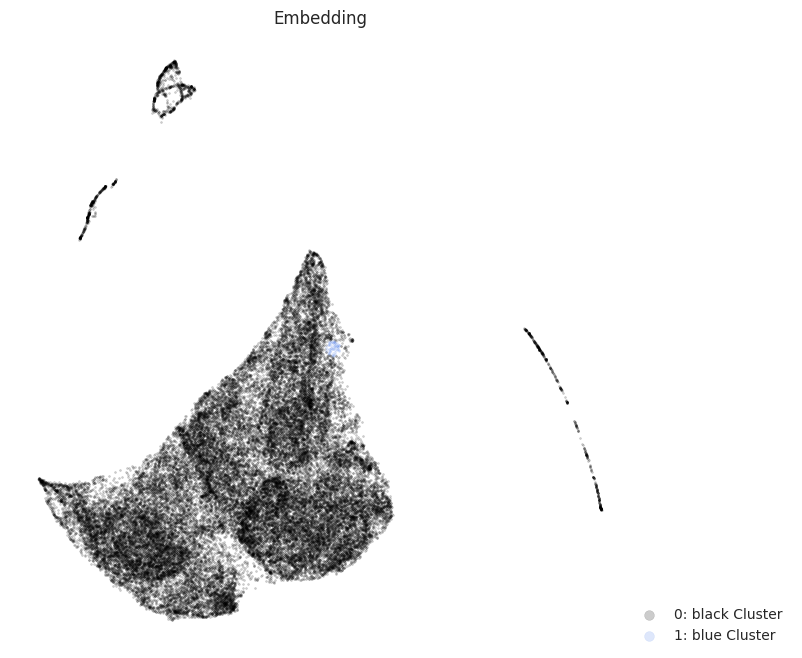

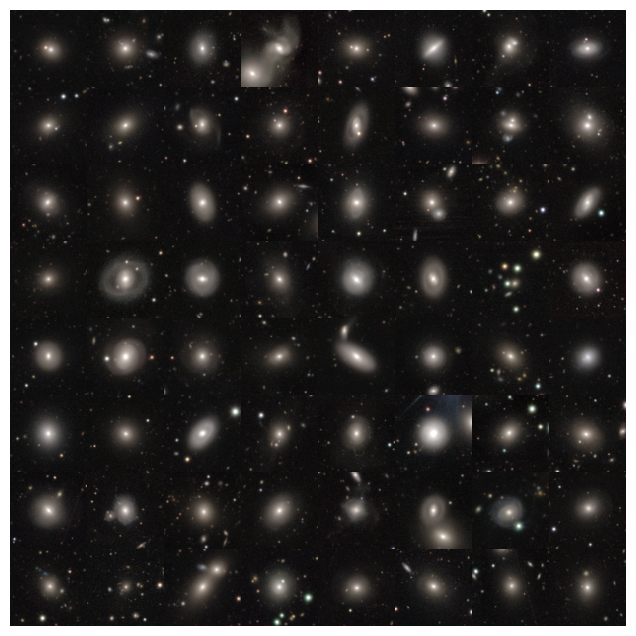

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


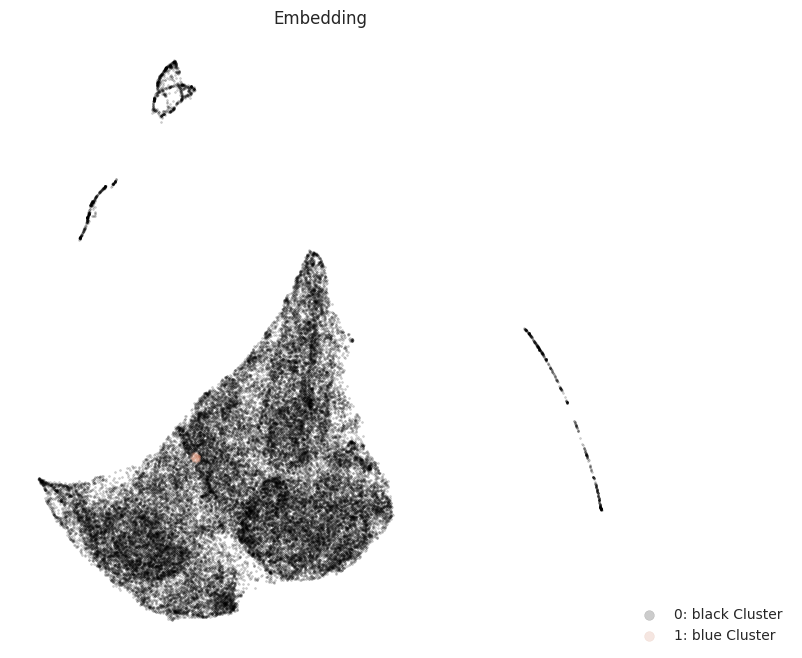

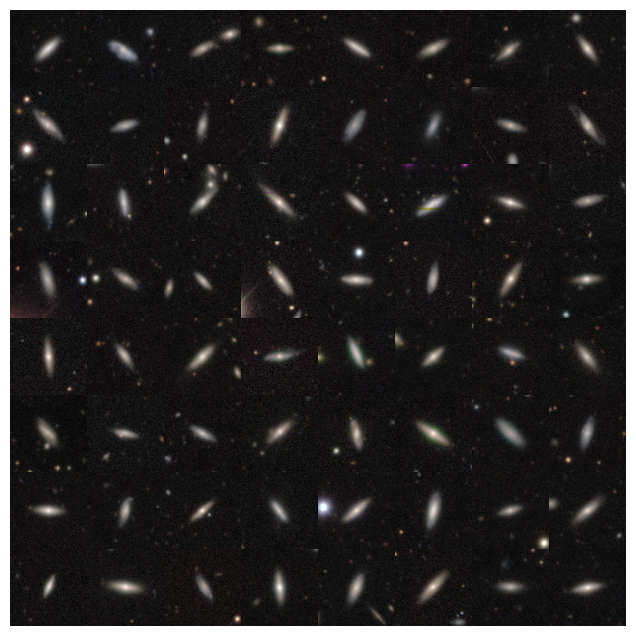

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


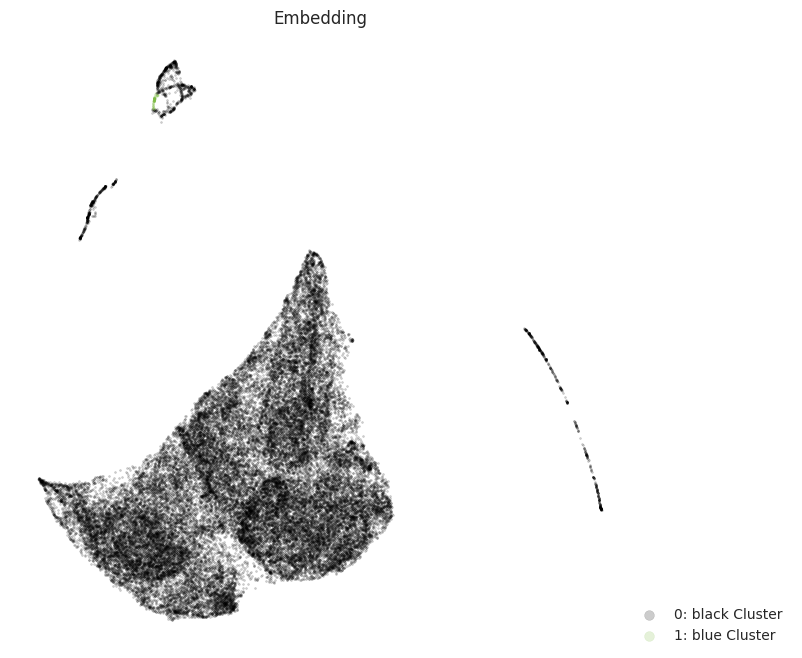

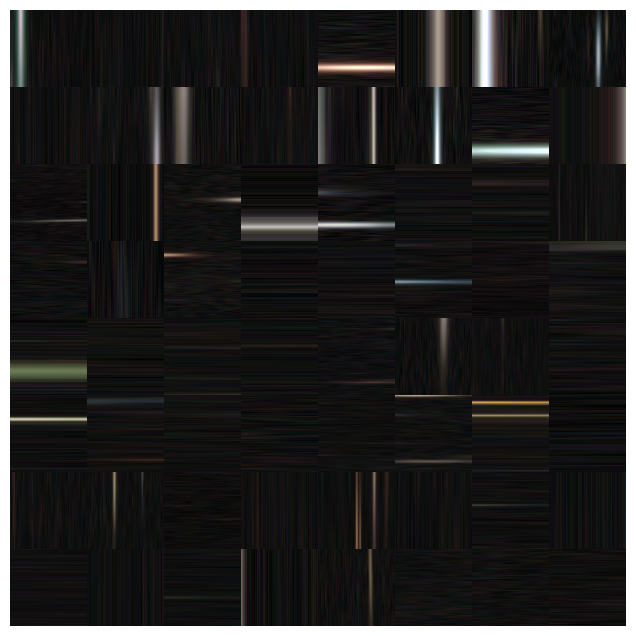

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


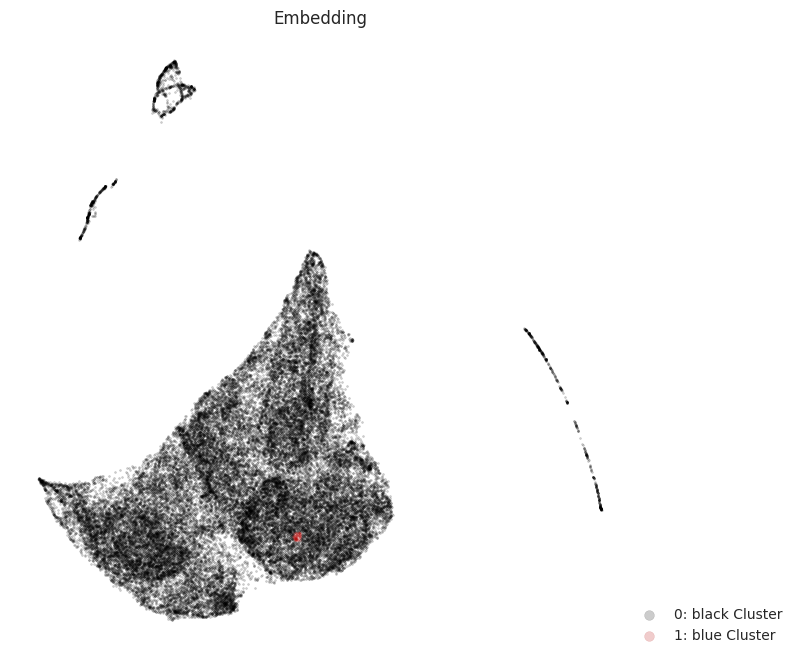

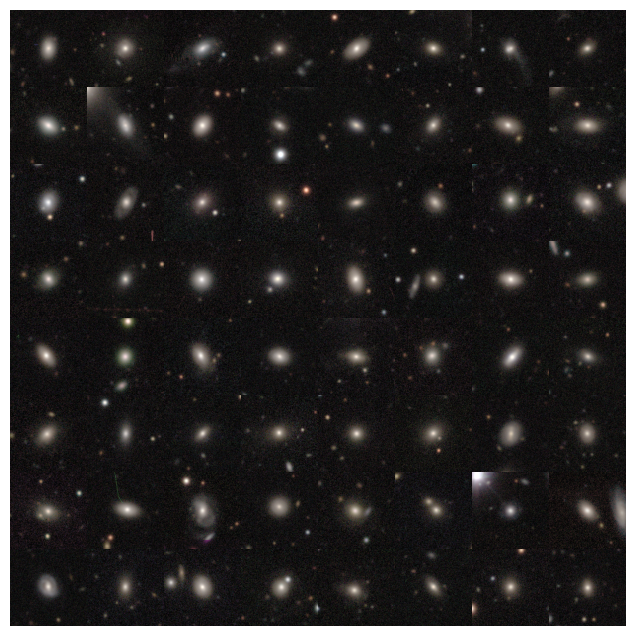

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


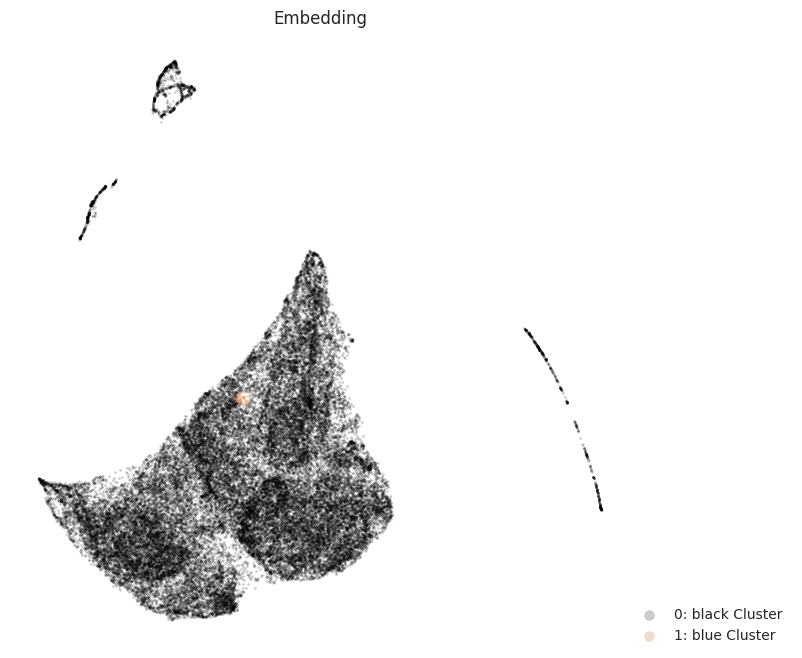

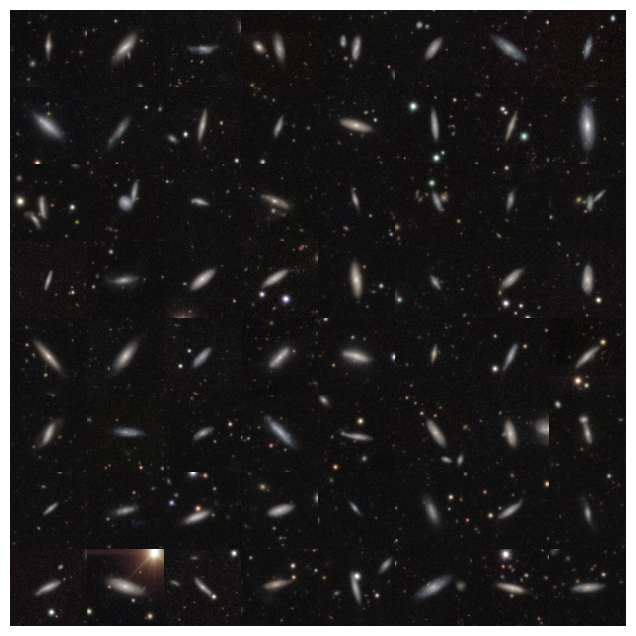

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


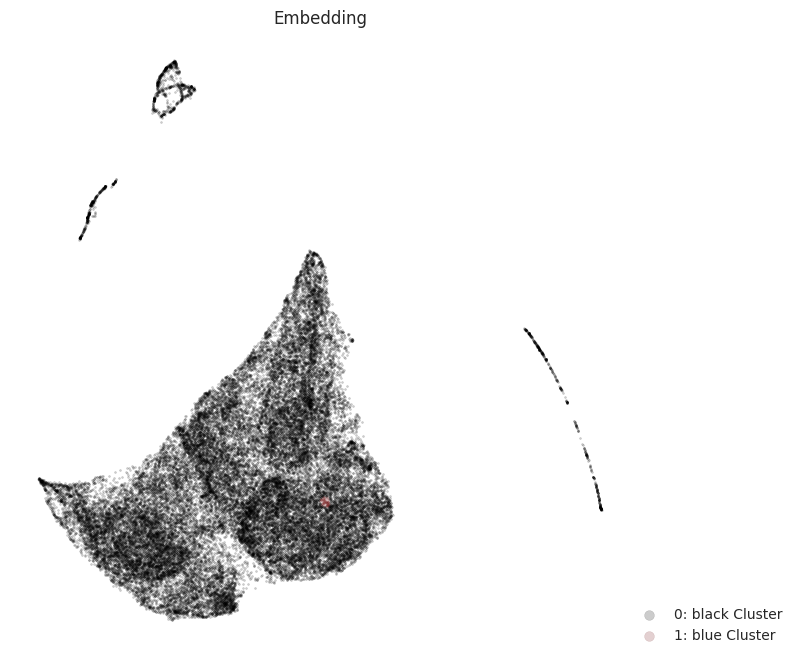

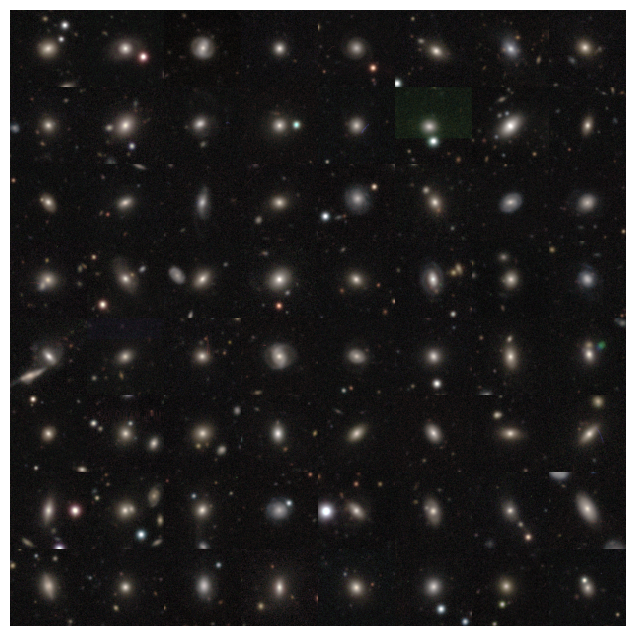

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


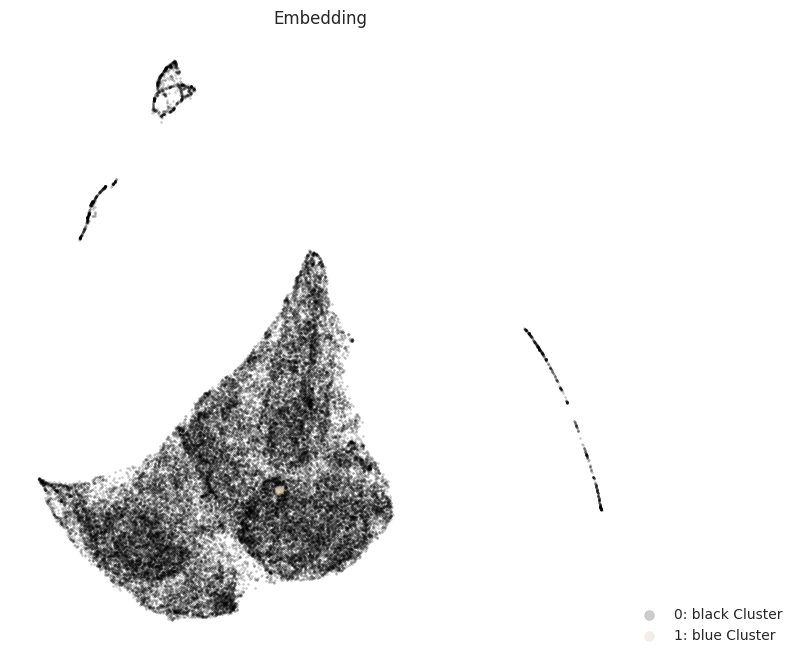

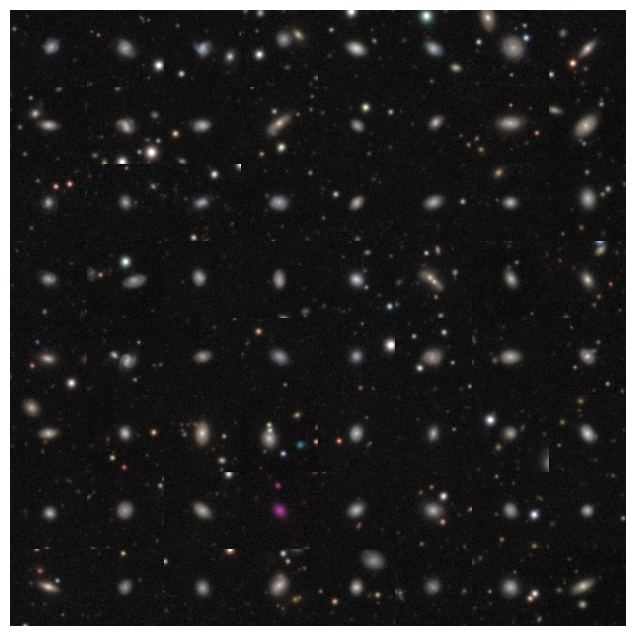

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


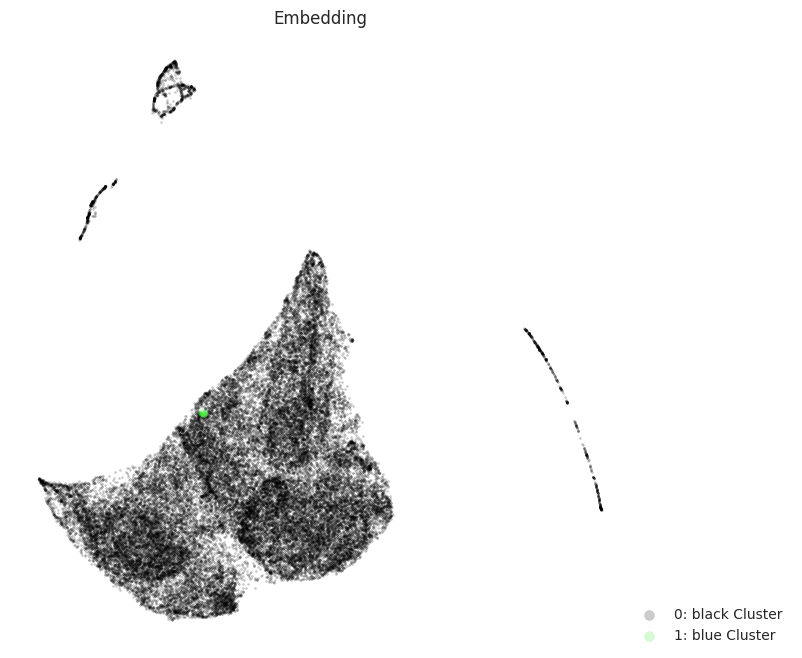

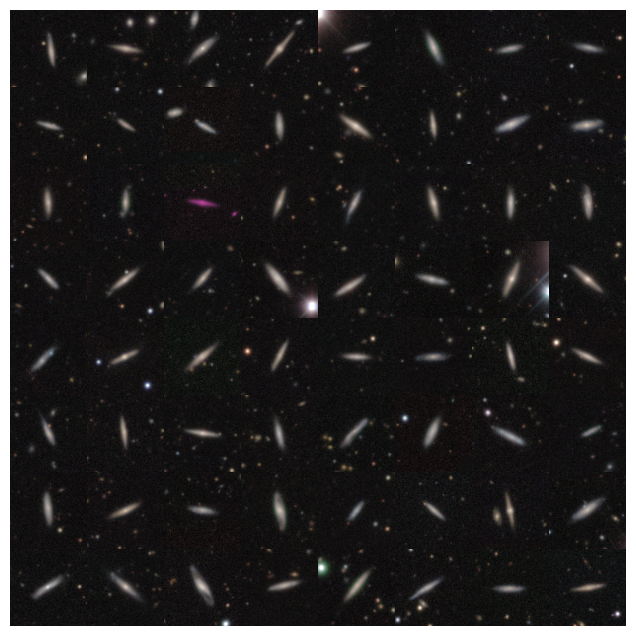

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


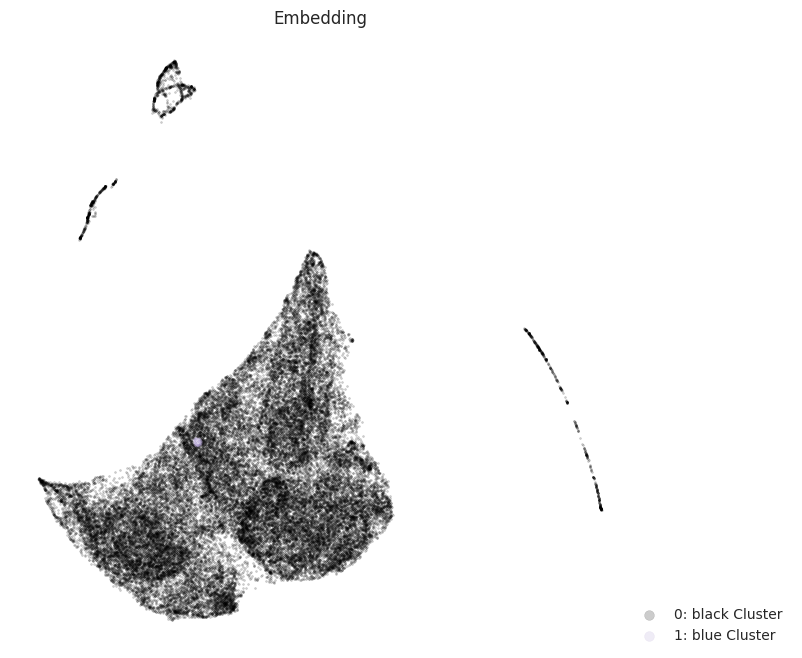

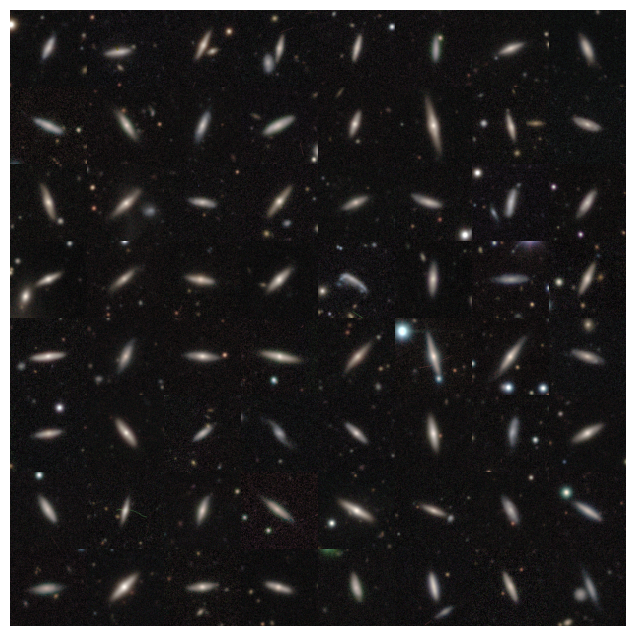

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


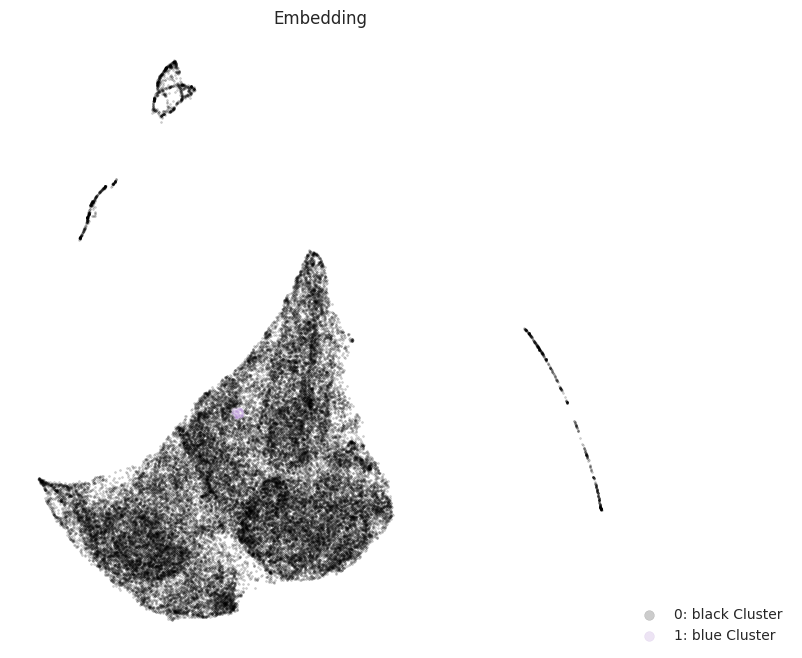

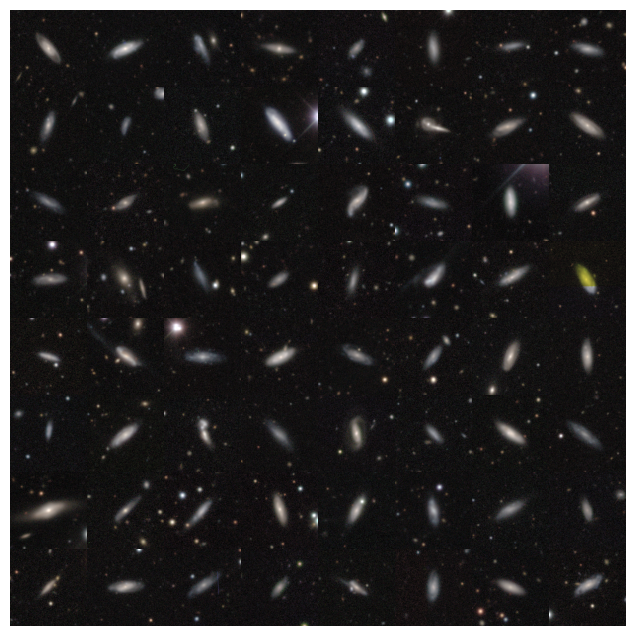

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


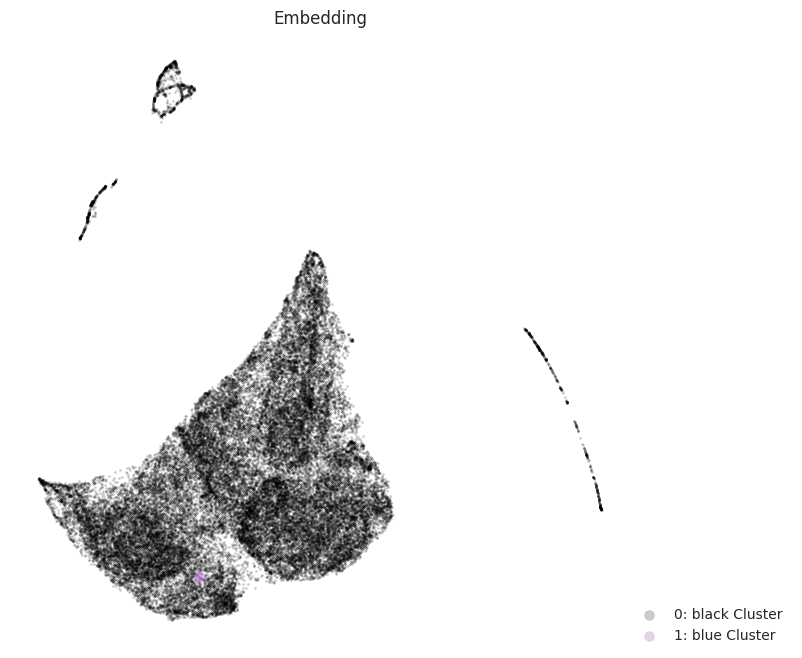

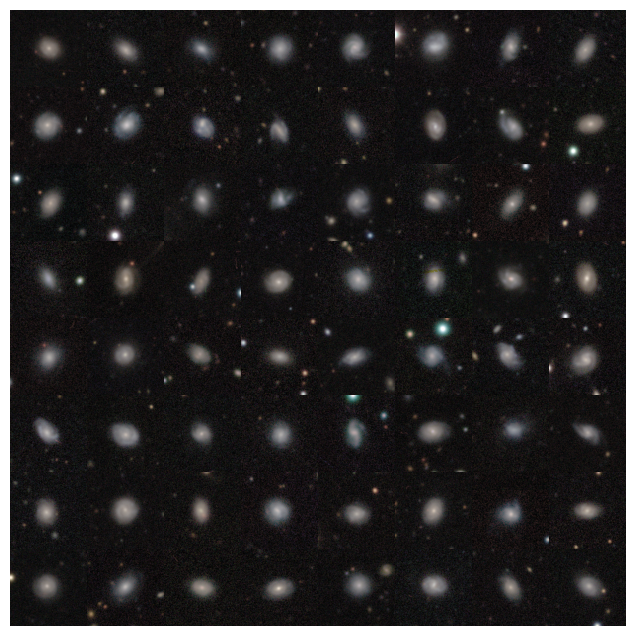

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


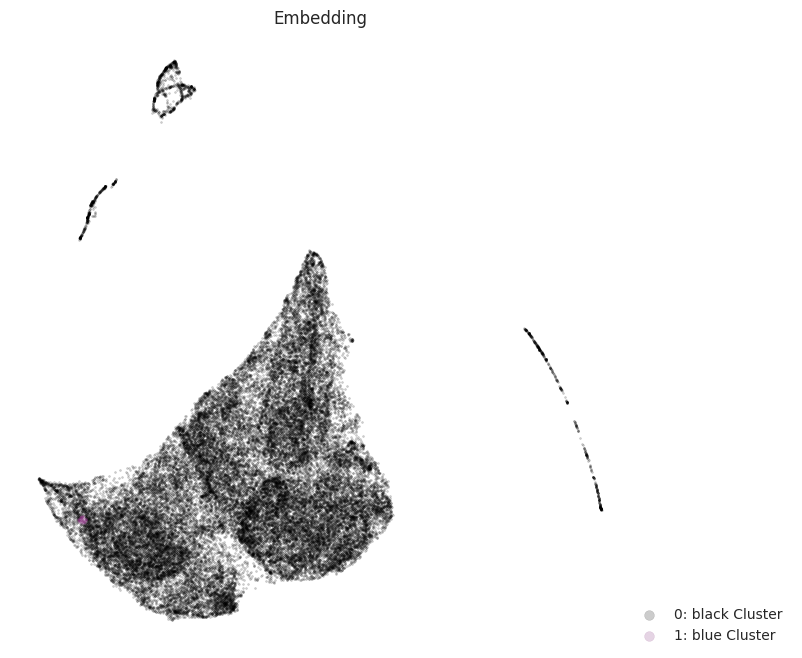

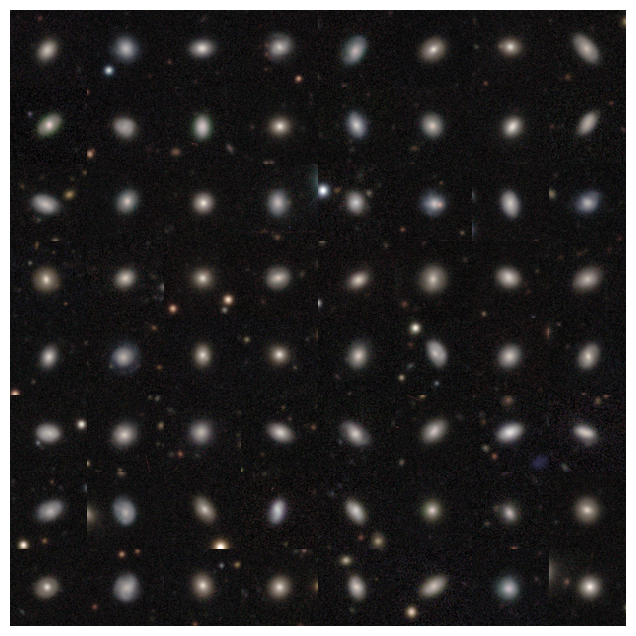

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Plotting


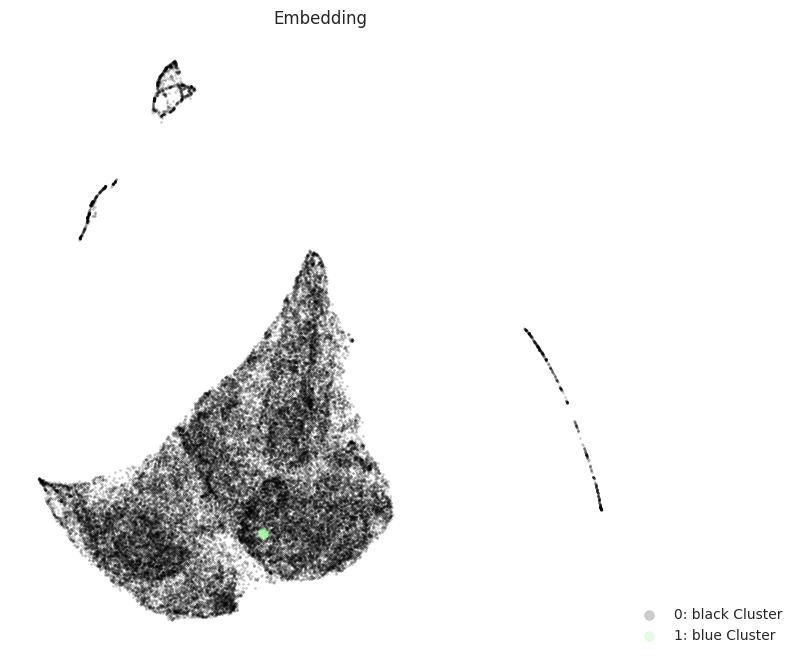

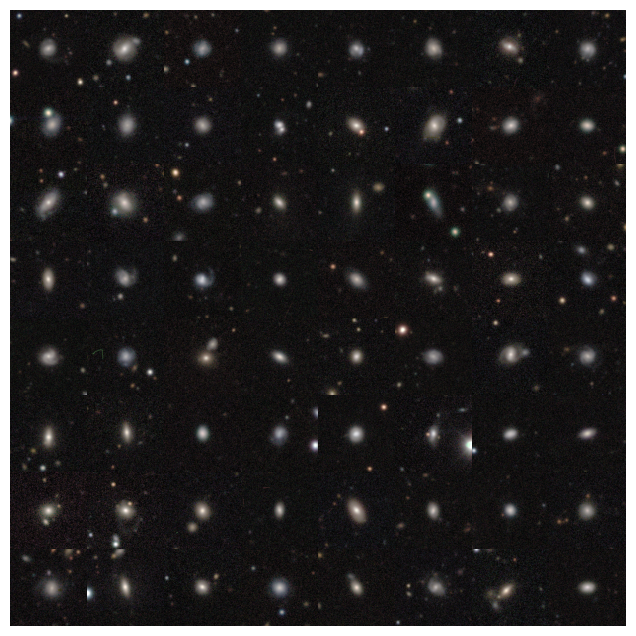

KeyboardInterrupt: 

In [148]:
#im = np.random.randint(10000, size=2)
Dir = "/idia/projects/hippo/Koketso/galaxyzoo/galaxy_zoo_12/"
importlib.reload(viz)
im = [7251,4000]
im = np.random.randint(1,700,20)
print(im)
importlib.reload(imf)
for a in im:
    center_image = a
    
    #sim = viz.similarity_search(input_index = center_image,data = pca,number_of_neighbors = 10)
    sim2 = viz.similarity_searchb(input_index = center_image,data = umap_,number_of_neighbors = 8*8)
    #man.show_images([a],meerkat_dir)
    #imf.show_images([a],meerkat_dir)
    #imf.show_images(sim,meerkat_dir)
    viz.shade(umap_,sim2, alpha = 0.2, limits = None)#[-300,300,-300,300])
    plt.show()
    #viz.shade(pmap_2,sim2, alpha = 1)
    #plt.show()
    #viz.show_images(image_2,sim2,5)
    #imf.show_images(sim2,Dir,n_by_n = True,sqrt = 8)
    sim_names = [names[b] for b in sim2]
    imf.show_images(names = sim_names,n_by_n = True,directory = Dir, sqrt = 8)

In [ ]:
import kornia

import kornia.augmentation as K
import random

class RandomRotationWithCrop(K.RandomRotation):
    def __init__(self, degrees, crop_size, output_dim = 244,p = 0.5):
        super(RandomRotationWithCrop, self).__init__(degrees, p = 1)
        #super(RandomRotationWithCrop, self).__init__(crop_size)
        self.rotation_transform = K.RandomRotation(degrees)
        self.crop_transform = K.CenterCrop(crop_size, keepdim = False,align_corners = True)
        self.resize_transform = K.Resize(output_dim)
    def __call__(self, x):
        if random.random() <self.p:
            # Apply random rotation
            x = self.rotation_transform(x)

            # Apply center crop
            x = self.crop_transform(x)
            x = self.resize_transform(x)

        return x

In [ ]:
random.random()

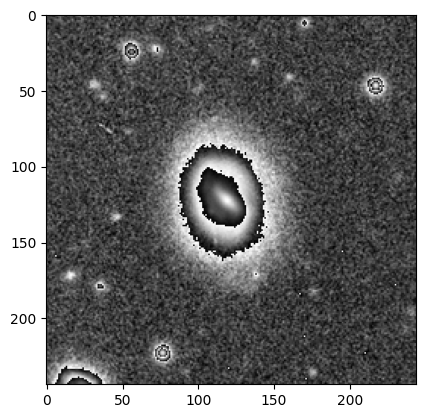

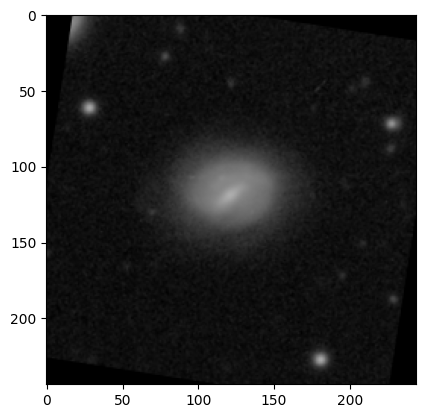

In [9]:
"""
t_comp =  tv.transforms.Compose([
                        tv.transforms.ToPILImage(),
                        kornia.augmentation.RandomRotation(180),
                        tv.transforms.ToTensor(),
                        tv.transforms.Resize(300),
                        tv.transforms.CenterCrop(224),
                        tv.transforms.Grayscale(num_output_channels = 3),
                        tv.transforms.Normalize(mean=mean, std=std)
         

                            ])
"""

import kornia
#trans_5 = kornia.augmentation.RandomGaussianBlur(kernel_size = [5,5],sigma = [4,4])
trans_5 = kornia.augmentation.RandomRotation([0,360], p=1,keepdim = True, align_corners= True)
#trans_5 = kornia.augmentation.RandomResizedCrop([244,244],scale = (0.6,1), p = 1)
trans_2 = tv.transforms.ToTensor()
trans_3 = tv.transforms.Resize(244)

trans_4 = tv.transforms.CenterCrop(244)
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]
trans_6 = tv.transforms.Normalize(mean=mean, std=std)
trans_7 = tv.transforms.Grayscale(num_output_channels = 3)
a= 22012
im1 = trans_2(imf.folder_image_index(galaxyzoo_dir,a)[0])


b_im = trans_7(trans_4(trans_5(trans_3(im1.reshape([1,3,400,400])))))


#b_im = t_comp(trans_3(im1.reshape([1,3,512,512])))
plt.imshow(tv.transforms.ToPILImage()(trans_3(trans_7(trans_6((trans_2(imf.folder_image_index(galaxyzoo_dir,a)[0])))))))
plt.show()
plt.imshow(tv.transforms.ToPILImage()(b_im[0]))
plt.show()

# Clustering

## PCA AND KMEANS

In [38]:
pca = viz.pca(data = rep,n_components = min([1000,len(rep[1])]), variance = 0.95)

Variance to keep :  0.9513327139969409  number of components :  24


In [46]:
from sklearn.cluster import KMeans
n = 15
time_stamp = time.time()
km = KMeans(n_clusters=n,
            init='random',
            n_init=10,
            max_iter=300,
            tol=0.0001,
            verbose=0, 
            random_state=23, 
            copy_x=True,
            algorithm='auto')

k_labels = km.fit_predict(pca)
time2 = time.time()
print(-time_stamp + time.time())

/idia/projects/hippo/Koketso/deepclustering2/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1318: FutureWarning: algorithm='auto' is deprecated, it will be removed in 1.3. Using 'lloyd' instead.
  warnings.warn(


1.7838776111602783


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

Plotting


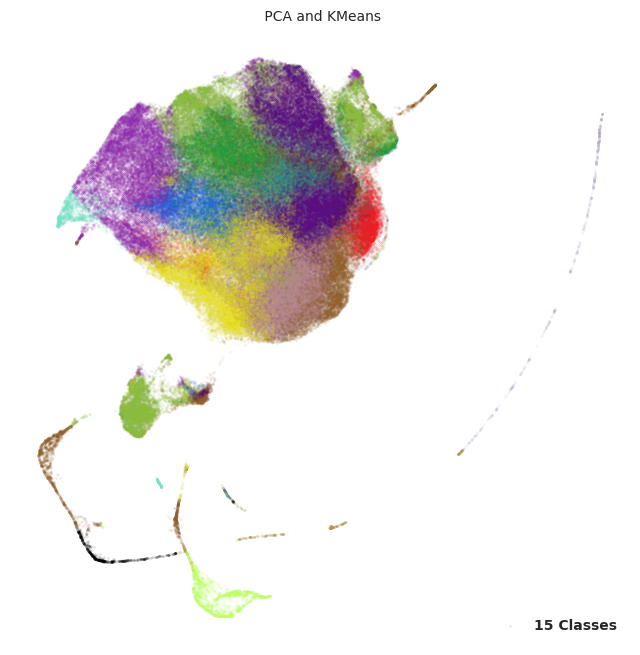

In [49]:
importlib.reload(viz)
viz.shade(umap_,k_labels,numof_class = max(k_labels)+1,label = False,name = " PCA and KMeans",alpha = 0.1, limits =None)# [-5,7,-6,6])

## UMAP and HDBSCAN

In [ ]:
rep = rep_2
name = name_2

In [119]:
np.random.rand(1, 3)

array([[0.9388126 , 0.78884211, 0.38503094]])

In [110]:
import matplotlib.cm as cm
colors = cm.rainbow(np.linspace(0, 1, 20))
colors

UMAP(low_memory=False, n_neighbors=20, random_state=43, transform_seed=4, verbose=True)
Wed Jul  5 16:28:14 2023 Construct fuzzy simplicial set
Wed Jul  5 16:28:14 2023 Finding Nearest Neighbors
Wed Jul  5 16:28:15 2023 Building RP forest with 29 trees
Wed Jul  5 16:28:18 2023 NN descent for 18 iterations
	 1  /  18
	 2  /  18
	 3  /  18
	 4  /  18
	Stopping threshold met -- exiting after 4 iterations
Wed Jul  5 16:28:39 2023 Finished Nearest Neighbor Search
Wed Jul  5 16:28:41 2023 Construct embedding


Epochs completed: 100%| ██████████ 200/200 [03:31]


Wed Jul  5 16:32:50 2023 Finished embedding
Saved :  uembedded_dataset.txt
UMAP reduced in  291.2846419811249


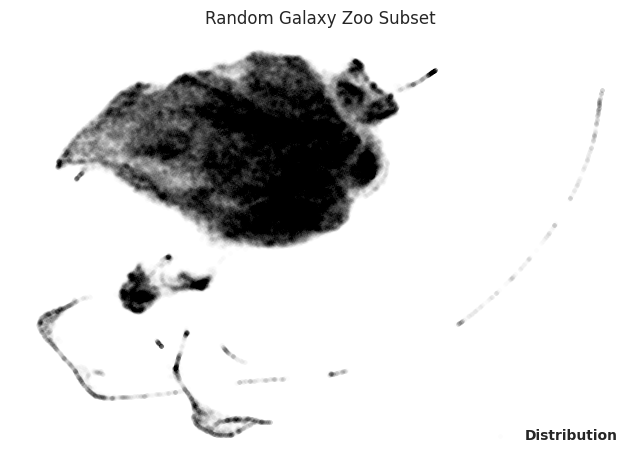

In [48]:
umap_ =viz.umap(rep,name ="Random Galaxy Zoo Subset", min_dist = 0.1, alpha = 0.01) #min_dist = 0.1 for hand sign data

In [70]:
rep_file.insert(0,"PCA_KMeans",g_labels)
rep_file

,PCA_KMeans,PCA_Gaussian_Mixture_labels,UMAP_Gaussian_Mixture_labels,Unnamed: 0,Image Name,Feature: 0,Feature: 1,Feature: 2,Feature: 3,Feature: 4,...,Feature: 502,Feature: 503,Feature: 504,Feature: 505,Feature: 506,Feature: 507,Feature: 508,Feature: 509,Feature: 510,Feature: 511
0,7,7,13,0,J100015.59+003059.0.png,0.426747,0.087485,0.121010,0.079349,0.525622,...,1.353843,0.230568,0.874366,0.262004,0.730673,1.077288,0.228246,1.170940,0.000000,0.556692
1,2,2,15,1,J123625.55+095452.0.png,0.553761,0.478806,0.177719,0.406933,0.901579,...,0.343035,0.399478,0.212830,1.068427,0.658402,0.663162,0.131687,0.562534,0.305015,0.726887
2,10,10,11,2,J152050.59+180549.9.png,0.527676,0.464426,0.912920,0.076241,0.964236,...,0.750969,0.279393,0.437965,0.723253,0.413569,0.319226,0.232873,0.450728,0.327773,0.917796
3,10,10,1,3,J151702.25+155820.3.png,0.418950,0.459894,0.326380,0.210123,0.917605,...,0.298749,0.257945,0.209800,0.782944,0.385692,0.429596,0.157919,0.451288,0.437021,0.876403
4,2,2,19,4,J232254.29-003721.9.png,0.102197,0.278979,0.864849,0.243254,0.984269,...,0.438189,0.533676,0.875903,0.766333,0.505940,0.809141,0.126962,0.366342,0.407773,0.797156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200095,14,14,2,200095,J160639.88+045607.7.png,0.311325,2.947619,3.172403,5.403710,0.341425,...,0.000000,0.504870,0.054418,4.268483,0.374481,2.780644,10.615540,1.005881,3.931331,0.014288
200096,13,13,12,200096,J140852.45+122046.1.png,0.371948,0.516948,1.025141,0.261949,0.938046,...,0.394922,0.443266,0.602601,0.742333,0.474589,0.672228,0.225134,0.433798,0.382934,0.840344
200097,3,3,3,200097,J155522.15+051302.4.png,0.000000,4.363233,0.736688,2.904403,0.059914,...,2.082724,0.011005,0.000000,1.030042,4.012855,1.073800,3.232778,0.637975,3.352776,1.851876
200098,12,12,7,200098,J135829.96+195358.0.png,0.594452,0.334257,0.565118,0.122962,0.979216,...,0.459472,0.392784,0.594751,0.771006,0.393263,0.607414,0.295508,0.389233,0.569391,0.832118


In [71]:
rep_file.to_csv('200sample_res18byol_0_features.csv')

In [4]:
umap_cluster = viz.umap(rep,scatter = True,name = "UMAP Distribution", dim = 10, min_dist = 0.0, n_neighbors = 30,alpha = 0.2)

UMAP(low_memory=False, min_dist=0.0, n_components=10, n_neighbors=30, random_state=43, transform_seed=4, verbose=True)
Sat Jun 10 15:40:24 2023 Construct fuzzy simplicial set
Sat Jun 10 15:40:24 2023 Finding Nearest Neighbors
Sat Jun 10 15:40:24 2023 Building RP forest with 27 trees
Sat Jun 10 15:40:28 2023 NN descent for 18 iterations
	 1  /  18
	 2  /  18
	 3  /  18
	 4  /  18
	Stopping threshold met -- exiting after 4 iterations
Sat Jun 10 15:44:41 2023 Finished Nearest Neighbor Search
Sat Jun 10 15:44:47 2023 Construct embedding


Epochs completed: 100%| ██████████ 200/200 [05:39]


Sat Jun 10 15:51:19 2023 Finished embedding
Saved :  uembedded_dataset.txt
UMAP reduced in  668.7310144901276


In [21]:
pca = viz.pca(data = rep,n_components = min([1000,len(rep[1])]), variance = 0.95)

Variance to keep :  0.9512156374466935  number of components :  31


In [39]:
time_stamp = time.time()
hdbclasses = viz.HDBSCAN(pca,min_cluster_size = 1000, min_samples = 50)
h_labels = hdbclasses
h_labels = [a+1 for a in h_labels]
time2 = time.time()
print(time2-time_stamp)
print(viz.groups(h_labels))

In [64]:
from sklearn.mixture import BayesianGaussianMixture

time_stamp = time.time()

g_labels = BayesianGaussianMixture(n_components=50, n_init = 10).fit(pca)

#db_labels = [a+1 for a in db_labels]
time2 = time.time()
print(time2-time_stamp)

/idia/projects/hippo/Koketso/deepclustering2/lib/python3.8/site-packages/sklearn/mixture/_base.py:286: ConvergenceWarning: Initialization 1 did not converge. Try different init parameters, or increase max_iter, tol or check for degenerate data.
  warnings.warn(


1098.5476732254028


In [70]:
a = np.sort(g_labels.weights_)
b = [round(k,2) for k in a]

In [74]:
sum([f>0 for f in b])

38

In [104]:
gg_labels = g_labels.predict(pca)

In [66]:
from sklearn.mixture import GaussianMixture

import time
time_stamp = time.time()

gm_labels = GaussianMixture(n_components=19, random_state=42).fit_predict(pca)

#db_labels = [a+1 for a in db_labels]
time2 = time.time()
print(time2-time_stamp)

179.44714379310608


In [ ]:
importlib.reload(viz)
viz.groups(gg_labels)

In [118]:
cluster = sum([int(a ==2) for a in gg_labels])
cluster

3321

In [123]:
print(len(k_labels))
print(len(gg_labels))
print(len(umap_))

230575
230575
230575


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

Plotting


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

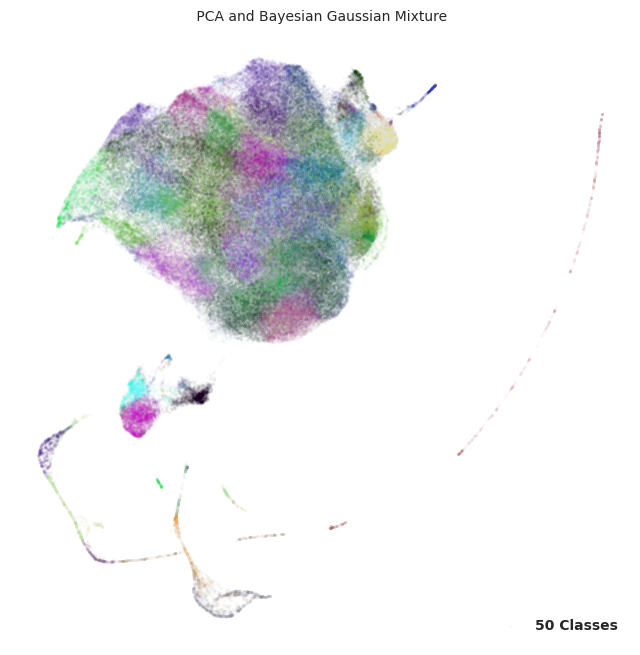

In [128]:
importlib.reload(viz)
viz.shade(umap_,gg_labels,numof_class = max(gg_labels)+1,label = False,name = " PCA and Bayesian Gaussian Mixture",alpha = 0.03, limits =None)# [-5,7,-6,6])

# UMAP  and Agglomerative Clustering

In [ ]:
from sklearn.cluster import AgglomerativeClustering
dbscan =  AgglomerativeClustering(n_clusters = 20,linkage = 'single', distance_threshold=None,compute_distances = False).fit(umap_cluster)
d_labels = dbscan.labels_
print(viz.groups(d_labels))

In [74]:
#d_labels = [a+1 for a in d_labels]
print(viz.groups(g_labels))

[5279, 68, 600, 162, 17, 52, 4647, 4824, 3359, 449, 158, 134, 5237, 4577, 4795, 4049, 3974, 1286, 223, 3789]


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

Plotting


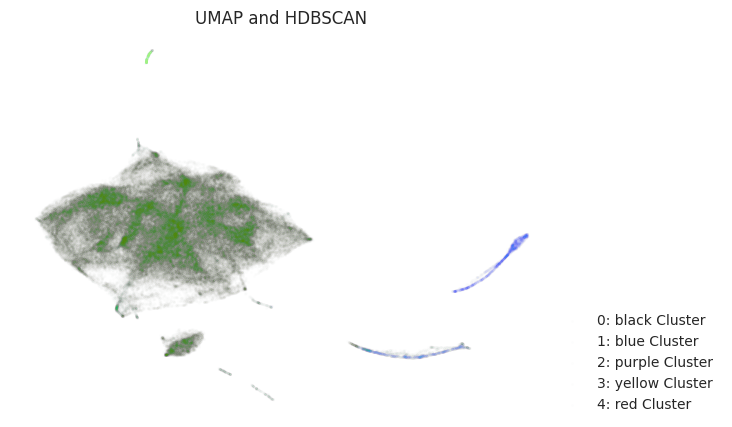

In [169]:
importlib.reload(viz)
viz.shade(umap_,h_labels,numof_class = max(h_labels)+1,label = True,name = "UMAP and HDBSCAN",alpha = 0.01, limits = None)#[-2,17,-2,17])

# Visualizing Clusters

Cluster: 0  Number:  13906


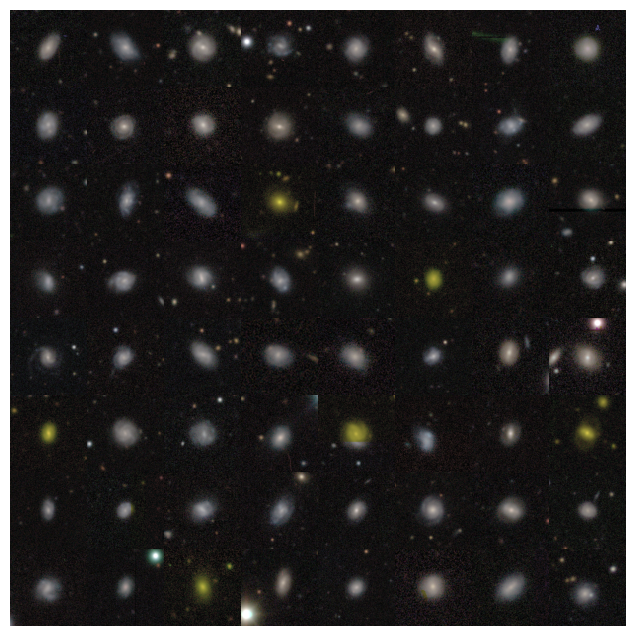

Cluster: 1  Number:  716


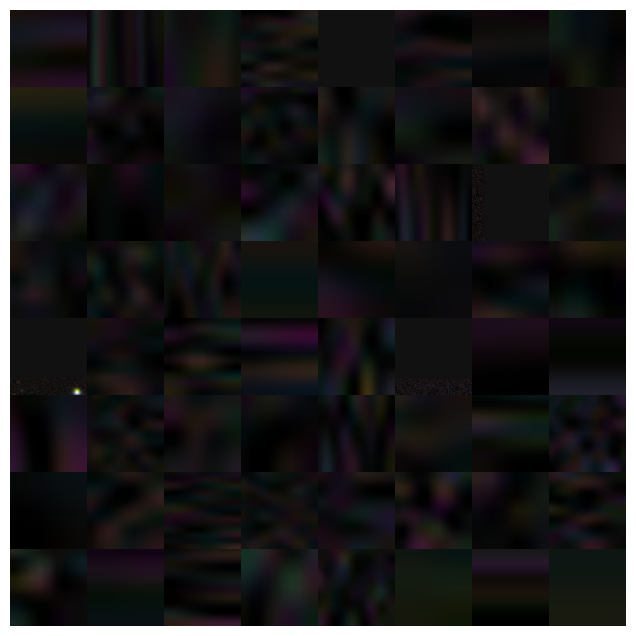

Cluster: 2  Number:  17702


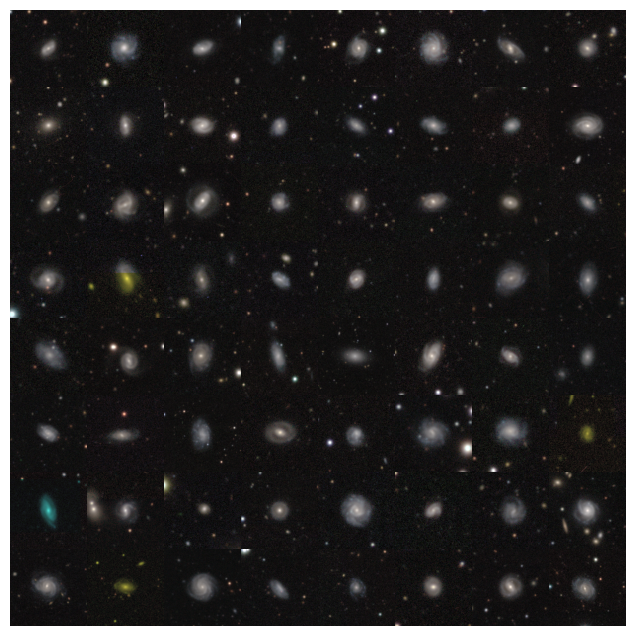

Cluster: 3  Number:  4182


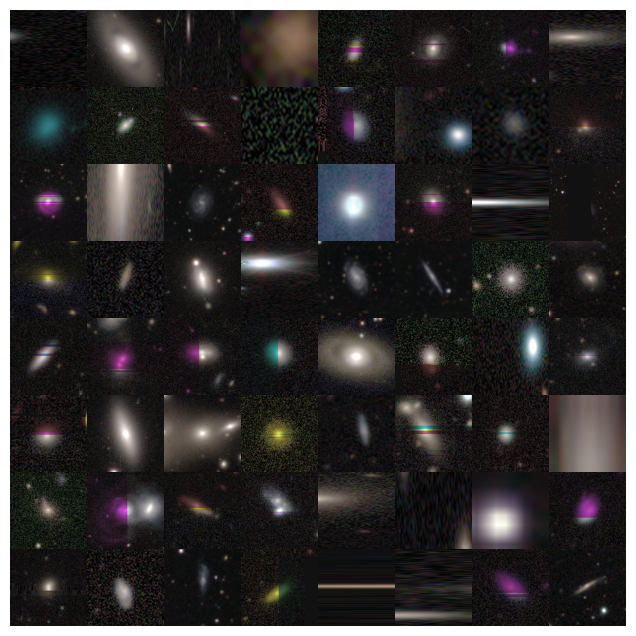

Cluster: 4  Number:  2619


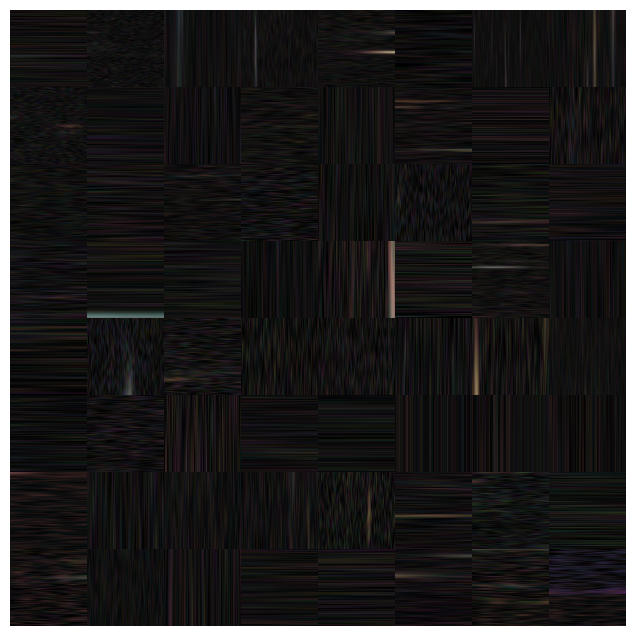

Cluster: 5  Number:  21821


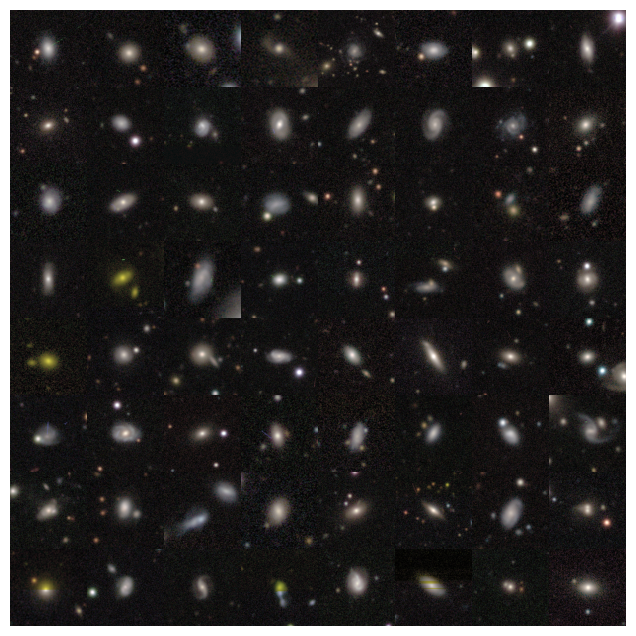

Cluster: 6  Number:  1195


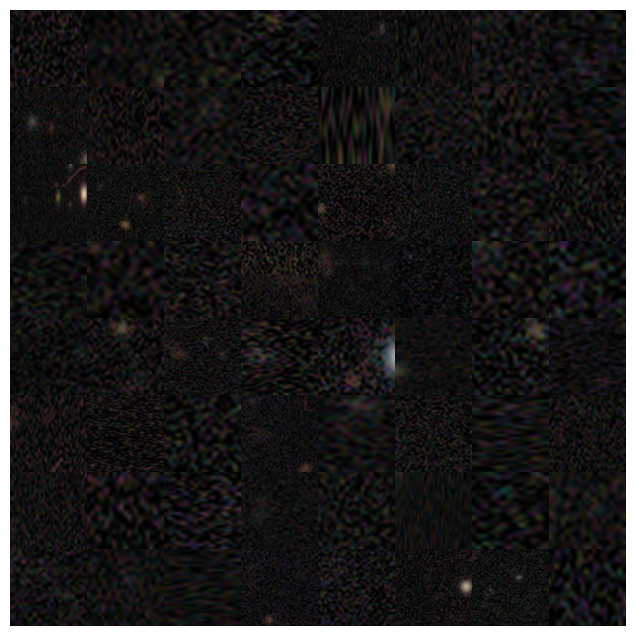

Cluster: 7  Number:  11932


In [ ]:
#Display Clusters
importlib.reload(imf)
#d_labels = dbscan.labels_
clusters_grouped = []
Dir = galaxyzoo_dir
clusters = g_labels
importlib.reload(imf)
for index in range(61):
    if viz.groups(clusters)[index]>64:
        mir_hd_0 = viz.indices(clusters,index,64)
        sim_names = [names[b] for b in mir_hd_0]
        clusters_grouped.append(sim_names)
        print("Cluster:", index, " Number: ", viz.groups(clusters)[index])
        #viz.shade(umap_,sim_names, alpha = 0.01)
        imf.show_images(names = sim_names,n_by_n = True,directory = Dir, sqrt = 8)

# Matching Clusters Against Galaxy Zoo labels

In [71]:
clust_dir = "/idia/projects/hippo/Koketso/galaxyzoo/clusters/"
import shutil
num_spiral = 0
num_ell = 0
importlib.reload(imf)
for i in range(20):
    
    for image_name in clusters_grouped[i]:
        im = imf.folder_image_name(Dir,image_name)
        
 
        if im != None:
            shutil.copy2(im[1], clust_dir+str(i+1))
        print(i)
        clear_output(wait =True)



19


In [76]:
# Given a cluster,
#what percentage of the images answered a certain way to a given question

#Display Clusters


import pandas as pd
importlib.reload(pd)
Class_file = "/idia/projects/hippo/Koketso/gz_decals_volunteers_5.csv?download=1.1"
Class_file = "/idia/projects/hippo/Koketso/gz_decals_volunteers_1_and_2.csv"
#Class_file2 = "/idia/projects/hippo/Koketso/gz_decals_auto_posteriors.parquet?download=1"
"""
Class_file = pd.read_csv(Class_file)
Class_file.set_index("iauname",
            inplace = True)
"""

Class_file2 = pd.read_csv(Class_file) 
Class_file2.set_index("iauname",
            inplace = True)

In [52]:
Class_file2.insert(2,"PCA_Kmean",["-" for a in range(92960)])

In [11]:
k_labels = rep_file.PCA_KMeans.values

In [4]:
names_in_label = list(Class_file2["iauname"])

In [5]:
clusters_as_in_labels = [-1]*len(names_in_label)

In [14]:
i = 0
for name in names:
    try:
        
        cluster= k_labels[names.index(name)] #for each name find cluster label
        image_index = names_in_label.index(name)         #find position in labelled fil
        clusters_as_in_labels[image_index] = cluster       # assign the cluster
        print(name)
        
        
    except:
        # do nothing, intialized as -1
        i +=1
        print(i)
        clear_output(wait = True)
    

J160639.88+045607.7
J140852.45+122046.1
J155522.15+051302.4
J135829.96+195358.0
J141107.80-013817.0


In [15]:
    
Class_file2.insert(2,"PCA_Kmeans",clusters_as_in_labels)

In [17]:
Class_file2.to_csv("Clustered_votes.csv")

In [ ]:
clusters = k_labels
#clustered = ["-" for a in range(92960)]
importlib.reload(imf)
importlib.reload(viz)


questions = [ 
            "smooth_or_featured_smooth_fraction",
            "how_rounded_completely_fraction" ,
            "how_rounded_cigar_shaped_fraction",
            "disk_edge_on_yes_fraction",
            "edge_on_bulge_none_fraction",
            "has_spiral_arms_yes_fraction",
            "spiral_winding_tight_fraction",
            "spiral_winding_loose_fraction",
            "bulge_size_obvious_fraction",
            "merging_merger_fraction"
    ]


table = []
#artefacts = [0,7,9,10,12,15]

for index in range(len(viz.groups(clusters))):
    cluster_size = viz.groups(clusters)[index]
    
    #Isolate the cluster
    #initialize cluster dictionary
    if 1:
    
        cluster_dict = {
                "CLUSTER":index,
                "smooth_or_featured_smooth_fraction":0,
                "how_rounded_completely_fraction":0,
                "how_rounded_cigar_shaped_fraction":0,
                "disk_edge_on_yes_fraction":0,
                "has_spiral_arms_yes_fraction":0,
                "spiral_winding_tight_fraction":0,
                "spiral_winding_loose_fraction":0,
                "bulge_size_obvious_fraction":0,
                "merging_merger_fraction":0,
                "Percentage Voted":0
        }

        if cluster_size > 900:
            print("Cluster:", index, " Number: ", cluster_size)

            mir_hd_0 = viz.indices_all(clusters,index)

            sim_names = [names[b] for b in mir_hd_0]

            #For every question count the number of images for which votes> 0.5

            for question in questions:

                num_correct = 0
                total = cluster_size
                for name in sim_names:
                    try:
                        num_correct += int(Class_file2[question][name]>0.5)
                        #clustered.append(index)
                    except:
                        total = total-1       #If it is not in the labels file, it doesnt coount
                        #clustered.append(-1)
                        
                if total ==0:
                    cluster_dict[question] = 0
                else:

                    cluster_dict[question] = round((num_correct/total),2)

            table.append(cluster_dict)
            clear_output(wait = True)
            print("Cluster:", index, " Number: ", cluster_size," Total Votes: ", total*100/cluster_size)

In [51]:
int(Class_file2[question]["J000001.85+004309.3"]>0.5)

0

In [ ]:
for index in range(10):

    fig = plt.figure(figsize = (10, 5))
    a = questions[index]


    plt.bar([str(cluster['CLUSTER']) for cluster in table],[cluster[a] for cluster in table],edgecolor='black', width = 1)


    plt.ylabel(a)
    plt.xlabel("Cluster")
    plt.title(a)
    plt.show()

In [97]:
print(Class_file2.index.names)

['iauname']


In [66]:
Class_file2.insert(2,"PCA_Kmean",clustered)

In [73]:
len(names)

200100

In [59]:
Class_file2.insert(2,"PCA_Kmean",["-" for a in range(92960)])

In [108]:
list(Class_file2.index).index("J133751.46+253954.0")

ValueError: 'J133751.46+253954.0' is not in list

In [43]:
table_pickle = "cluster_matches_gm_umap.plk"

with open(table_pickle,'rb') as file:
    pickle.dump(table,file)

In [21]:
with open(table_pickle,'wb') as file:
    pickle.dump(table,file)

In [ ]:

cluster_names = [str(cluster['CLUSTER']) for cluster in table]


qs = [ 
            "smooth",
            "rounded" ,
            "cigar_shapes",
            "disk_edge",
            "no_edge_on_bulge",
            "spiral_arms",
            "tight_spiral",
            "loose_spiral",
            "obvious_bulge",
            "merging_merger"
    ]

data = {'Cluster number': cluster_names,
        
      }

#Create Dataframe
df = pd.DataFrame(data)
df.set_index("Cluster number")


# Insert the representations
i = 0
for question in questions:
    df.insert(i+1,qs[i],[round(cluster[question],2) for cluster in table])
    i+=1


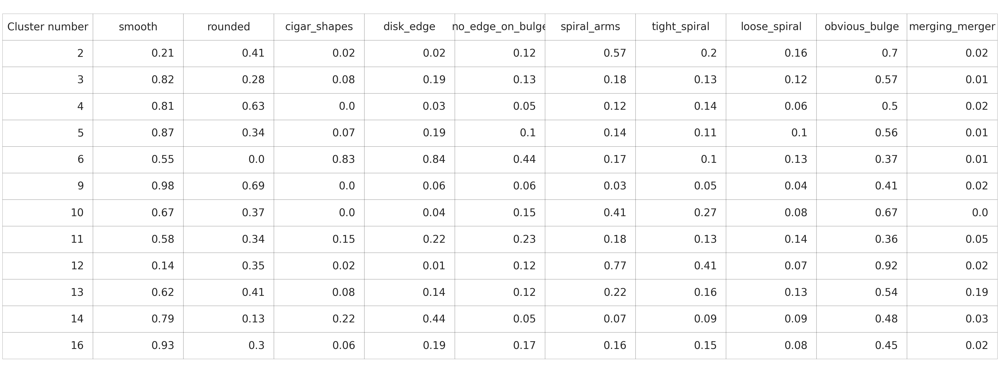

In [96]:
from pandas.plotting import table  # EDIT: see deprecation warnings below

# Plot the DataFrame as a table
fig, ax = plt.subplots(figsize=(40, 15))
ax.axis('off')  # Remove axis
tble = ax.table(cellText=df.values, colLabels=df.columns, loc='center')
# Adjust table properties
tble.auto_set_font_size(False)
tble.set_fontsize(30)
tble.scale(1, 5)  # Increase the table size

# Adjust figure properties
plt.tight_layout()  # Fit the table within the figure
fig.patch.set_visible(True)
ax.axis('off')  # Remove axis

plt.show()

In [87]:
tbl.scale?

Signature: tbl.scale(xscale, yscale)
Docstring: Scale column widths by *xscale* and row heights by *yscale*.
File:      /idia/projects/hippo/Koketso/deepclustering2/lib/python3.8/site-packages/matplotlib/table.py
Type:      method


In [ ]:
Class_file2.insert(2,"PCA_Kmeans",clustered)

In [ ]:
questions = {}
questions.append("cluster 1",cluster)

In [ ]:
"""
sn_metric_name = "Some_lobel"
plt.close('all')
sn_metric_name = metric_names.loc['sn', 'v2_0_name']
fig = plt.figure()
xvals = maf_output.loc[intersection, sn_metric_name].values
yvals = sn_metrics.loc[intersection, 'nsn'].values
plt.plot(xvals, yvals, '.')
plt.xlabel(sn_metric_name)
plt.ylabel('DESC NSN')
ax = plt.gca()
annot = ax.annotate("note", xy=(xvals.min(), yvals.min()), xytext=(5,5),textcoords="offset points")
annot.set_visible(False)
"""


def onclick(event):
    print('%s click: button=%d, x=%d, y=%d, xdata=%f, ydata=%f' %
          ('double' if event.dblclick else 'single', event.button,
           event.x, event.y, event.xdata, event.ydata))
    
    # Find the closest data point
    r = np.sqrt((event.xdata-xvals)**2 + (event.ydata-yvals)**2)
    idx = intersection[np.argmin(r)]
    annot.set_text(idx)
    annot.xy = (event.xdata, event.ydata)
    annot.set_visible(True)

cid = fig.canvas.mpl_connect('button_press_event', onclick)
plt.show()

In [ ]:
from sklearn.cluster import KMeans
n = 2
km = KMeans(n_clusters=n,
            init='random',
            n_init=10,
            max_iter=300,
            tol=0.0001,
            verbose=0, 
            random_state=23, 
            copy_x=True,
            algorithm='auto')

km2 = km.fit_predict(tmap)
"""
km_pickle = "km2_pickle.pkl"
with open(km_pickle,'wb') as file:
    pickle.dump(km2,file)
"""
#

In [ ]:
#similarity search
importlib.reload(viz)
viz.Similarity_index(labels,km2)


In [ ]:
def similarity_searchb(input_index = int,data = list,number_of_neighbors = 10,return_indices = True,print_images = True):

    def distance(index1,index2):
        return np.linalg.norm(np.array(data[index1])-np.array(data[index2]))
    neighbors = []
    distances = []
    len_data = len(data) 
    
    for j in range(number_of_neighbors):
        
        jthclosest_index = 0
        jthclosest_distance = distance(input_index,0) 
        for i in range(len_data):
            distance_to_input = distance(input_index,i)
            if jthclosest_distance >= distance_to_input:
 
                if i not in neighbors:
                    jthclosest_distance = distance_to_input
                    jthclosest_index = i

        neighbors.append(jthclosest_index)

    return neighbors
sim = similarity_search(input_index = center_image,data = umap_,number_of_neighbors = 500)
viz.shade(umap_,sim)

In [ ]:
from numpy import random
def similarity_search(input_index = int,data = list,number_of_neighbors = 10,return_indices = True,print_images = True):

    def distance(index1,index2):
        return np.linalg.norm(np.array(data[index1])-np.array(data[index2]))
 

    neighbors = []
    distances = []
    len_data = len(data)
    #Initialize random neighbors

    for j in range(number_of_neighbors):
        random_index = random.randint(0,len_data)
        distances.append(distance(input_index,random_index))
        neighbors.append(random_index)
    max_before_loop = max(distances)
    max_after_loop = min(distances)

    while( max_before_loop != max_after_loop):

        for i in range(len_data):

            distance_to_i = distance(input_index,i)
            furtherst_neighbor = max(distances) 

            if distance_to_i < furtherst_neighbor and i not in neighbors:
                furthese_negihbor_index = distances.index(furtherst_neighbor)
                distances[furthese_negihbor_index]  = distance_to_i      #if i is neare than the furthers neighbor of the input index, replace furthest neighbor with i
                neighbors[furthese_negihbor_index]   = i
        max_before_loop = max_after_loop
        max_after_loop = max(distances)
        a = np.sort(neighbors,axis = -1)    

    return np.sort(neighbors,axis = -1)        
similarity_search(input_index =140,number_of_neighbors = 50,data = tsne)

In [ ]:
4 not in [1,2,3,3,4]

In [ ]:
import numpy as np

vec = [5,20,30,60,90]
vec2 = [5,20,30,60,90]
for a in vec:
    for b in vec2:
        predic = viz.HDBSCAN(umap_,a,b)
        predic = np.where(predic == -1,predic.max(),predic)
        viz.shade(umap_,predic,predic.max()+1,"HDBSCAN " + str(b))
        print(a,b)

In [ ]:
print(umap_)
predic = viz.HDBSCAN(pca)
print(predic)
predic = np.where(predic == -1,predic.max(),predic)

In [ ]:
viz.shade(umap_,predic,predic.max()+1,"rpedic")

In [ ]:
viz.groups(imf.classes(Dir))

In [ ]:
predic = labels
Dir = galaxyzoo_dir
print(viz.groups(predic,0))
red = viz.indices(predic,0 , 10)
imf.show_images(red,Dir)
blue = viz.indices(predic,1 , 10)
imf.show_images(blue,Dir)
green = viz.indices(predic,2 , 10)
imf.show_images(green,Dir)
green = viz.indices(predic,3 , 10)
imf.show_images(green,Dir)
green = viz.indices(predic,4 , 1)
imf.show_images(green,Dir)
green = viz.indices(predic,5 , 1)
imf.show_images(green,Dir)

In [ ]:
importlib.reload(viz)
sim = viz.similarity_search(4627,umap_,number_of_neighbors = 200)
print(sim)

In [ ]:
import Meerkat_as_np as man
importlib.reload(viz)
importlib.reload(man)
print(len(umap_))
viz.similarity_search(4627,umap_)
a = 1234

man.show_images([4627],"meerkat")
for a in range(50):#[0,10,20,30,40,50,60,70,80,90]:
    print(viz.similarity_search(a,umap_,number_of_neighbors = 10))
    man.show_images([a],"galaxy_zoo")
    man.show_images(viz.similarity_search(a,umap_,number_of_neighbors = 10),"galaxy_zoo")
   

In [ ]:
for a in [10,100,1000,2000,3000,10000,15000,16000]:
    man.show_images(range(a,a+10),"meerkat")